In [25]:
import numpy as np
import pandas as pd
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, KFold, GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold, StratifiedKFold
from sklearn.metrics import mean_squared_error, accuracy_score, mean_absolute_error, precision_score, recall_score
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import RandomOverSampler
import matplotlib.pyplot as plt
%matplotlib inline
import joblib
from itertools import product
from imblearn.pipeline import Pipeline, make_pipeline
from imblearn.over_sampling import SMOTE
import shap

## Modeling Part 1: XGBoost Regression for Starting Pitchers

In [30]:
# Load 2016-19 starting pitcher data
data = pd.read_csv('2016-19sp.csv')

In [31]:
# Define features and target variable
X = data.drop(['playerid', 'Name', 'Team', 'League', 'Team_Traded', 'League_Traded', 'Team_Lag1', 
          'League_Lag1', 'IP_Tgt', 'W_Tgt', 'L_Tgt', 'SV_Tgt', 'BS_Tgt', 'HLD_Tgt', 'K_Tgt', 'HR_Tgt', 'ERA_Tgt', 
          'WHIP_Tgt', 'Dol_Tgt', 'IP_Tgt_Cat', 'W_Tgt_Cat', 'L_Tgt_Cat', 'SV_Tgt_Cat', 'BS_Tgt_Cat', 
          'HLD_Tgt_Cat', 'K_Tgt_Cat', 'HR_Tgt_Cat', 
          'ERA_Tgt_Cat', 'WHIP_Tgt_Cat', 'Dol_Tgt_Cat', 'IP_Tgt_Code', 'W_Tgt_Code', 'L_Tgt_Code', 'SV_Tgt_Code', 'BS_Tgt_Code', 
          'HLD_Tgt_Code', 'K_Tgt_Code', 'HR_Tgt_Code', 'ERA_Tgt_Code', 'WHIP_Tgt_Code', 'Dol_Tgt_Code'], axis=1)
y = data['IP_Tgt']

In [32]:
# Define all target variables
yip = data['IP_Tgt']
yw = data['W_Tgt']
yl = data['L_Tgt']
ysv = data['SV_Tgt']
ybs = data['BS_Tgt']
yhld = data['HLD_Tgt']
yk = data['K_Tgt']
yhra = data['HR_Tgt']
yera = data['ERA_Tgt']
ywhip = data['WHIP_Tgt']
ydolp = data['Dol_Tgt']

# Define lists of target variables and names
ys = [data['IP_Tgt'], data['W_Tgt'], data['L_Tgt'], data['SV_Tgt'], data['BS_Tgt'], data['HLD_Tgt'], data['K_Tgt'], 
      data['HR_Tgt'], data['ERA_Tgt'], data['WHIP_Tgt'], data['Dol_Tgt']]
names = ['yip', 'yw', 'yl', 'ysv', 'ybs', 'yhld', 'yk', 'yhra', 'yera', 'ywhip', 'ydolp']

In [5]:
# Create empty list to store best hyperparameters
best_params_list = []

In [6]:
def tuning(xtrain, ytrain, name):
    """Function to build XGBoost models and tune hyperparameters in multiple steps."""
    
    # Reset default hyperparameters
    param_dict = {'n_estimators':500, 'learning_rate':0.01, 'max_depth':5, 'subsample':0.4, 'colsample_bytree':0.3}
    
    # Define and train base model
    base_model = xgb.XGBRegressor(eval_metric='rmse', **param_dict, verbosity=0)
    
    print(base_model)

    base_model.fit(xtrain, ytrain)

    score = base_model.score(xtrain, ytrain)   
    print("Training score: ", score) 

    # Cross-validataion 
    scores = -cross_val_score(base_model, xtrain, ytrain, cv=5, scoring='neg_mean_absolute_error')
    print("Mean cross-validation score: %.2f" % scores.mean())

    kfold = KFold(n_splits=10, shuffle=True, random_state=RANDOMSTATE)
    kf_cv_scores = -cross_val_score(base_model, xtrain, ytrain, cv=kfold, scoring='neg_mean_absolute_error')
    print("K-fold CV average score: %.2f" % kf_cv_scores.mean())

    # Predict test data with base model
    base_ypred = base_model.predict(xtest)
    base_mae = mean_absolute_error(ytest, base_ypred)
    base_mse = mean_squared_error(ytest, base_ypred)
    print("Base MAE: %.2f" % base_mae)
    print("Base MSE: %.2f" % base_mse)
    print("Base RMSE: %.2f" % (base_mse**(1/2.0)))

    # Plot model performance
    x_ax = range(len(ytest))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="actual")
    plt.plot(x_ax, base_ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()

    # Display and save feature importance chart
    xgb.plot_importance(base_model, max_num_features = 15)
    plt.tight_layout()
    plt.savefig('base_'+name+'_1619.png')
    plt.show()
    
    # Display one decision tree
    fig, ax = plt.subplots(figsize=(30, 30))
    xgb.plot_tree(base_model, num_trees=20, rankdir='LR', ax=ax)
    plt.show()

    # Hyperparameter grid search step 1: max depth
    model = xgb.XGBRegressor(eval_metric='rmse', **param_dict)
    print(model)
    max_depth = range(3, 9, 1)
    param_grid = dict(max_depth=max_depth)
    kfold = KFold(n_splits=10, shuffle=True, random_state=RANDOMSTATE)
    grid_search = GridSearchCV(model, param_grid, scoring='neg_mean_absolute_error', n_jobs=-1, cv=kfold, verbose=1)
    grid_result = grid_search.fit(xtrain, ytrain)
    param_dict['max_depth'] = grid_result.best_params_['max_depth']
    print(grid_result.best_score_, grid_result.best_params_)

    # Hyperparameter grid search step 2: subsample, colsample_bytree
    model2 = xgb.XGBRegressor(eval_metric='rmse', **param_dict)
    print(model2)
    subsample = np.linspace(0.4, 1.0, 7)
    colsample_bytree = np.linspace(0.1, 0.35, 6)
    param_grid = dict(subsample=subsample, colsample_bytree=colsample_bytree, max_depth=[grid_result.best_params_['max_depth']])
    kfold = KFold(n_splits=10, shuffle=True, random_state=RANDOMSTATE)
    grid_search = GridSearchCV(model2, param_grid, scoring='neg_mean_absolute_error', n_jobs=-1, cv=kfold, verbose=1)
    grid_result = grid_search.fit(xtrain, ytrain)
    param_dict['subsample'] = grid_result.best_params_['subsample']
    param_dict['colsample_bytree'] = grid_result.best_params_['colsample_bytree']
    print(grid_result.best_score_, grid_result.best_params_)

    # Hyperparameter grid search step 3: learning rate
    model3 = xgb.XGBRegressor(eval_metric='rmse', **param_dict)
    print(model3)
    learning_rate = [0.0001, 0.001, 0.01, 0.1]
    param_grid = dict(learning_rate=learning_rate, subsample=[grid_result.best_params_['subsample']], 
                      colsample_bytree=[grid_result.best_params_['colsample_bytree']], 
                      max_depth=[grid_result.best_params_['max_depth']])
    kfold = KFold(n_splits=10, shuffle=True, random_state=RANDOMSTATE)
    grid_search = GridSearchCV(model3, param_grid, scoring='neg_mean_absolute_error', n_jobs=-1, cv=kfold, verbose=1)
    grid_result = grid_search.fit(xtrain, ytrain)
    param_dict['learning_rate'] = grid_result.best_params_['learning_rate']
    print(grid_result.best_score_, grid_result.best_params_)

    # Hyperparameter grid search step 4: number of estimators
    model4 = xgb.XGBRegressor(eval_metric='rmse', **param_dict)
    print(model4)
    n_estimators = [100, 200, 300, 400, 500]
    param_grid = dict(n_estimators=n_estimators, learning_rate=[grid_result.best_params_['learning_rate']], 
                      subsample=[grid_result.best_params_['subsample']], 
                      colsample_bytree=[grid_result.best_params_['colsample_bytree']], 
                      max_depth=[grid_result.best_params_['max_depth']])
    kfold = KFold(n_splits=10, shuffle=True, random_state=RANDOMSTATE)
    grid_search = GridSearchCV(model4, param_grid, scoring='neg_mean_absolute_error', n_jobs=-1, cv=kfold, verbose=1)
    grid_result = grid_search.fit(xtrain, ytrain)
    param_dict['n_estimators'] = grid_result.best_params_['n_estimators']
    best_params_list.append(param_dict)
    print(grid_result.best_score_, grid_result.best_params_)
    
    # Train best parameter model
    
    model5 = xgb.XGBRegressor(eval_metric='rmse', **param_dict)
    
    model5.fit(xtrain, ytrain)

    score = model5.score(xtrain, ytrain)   
    print("Training score: ", score) 

    # Cross-validataion 
    scores = -cross_val_score(model5, xtrain, ytrain, cv=5, scoring='neg_mean_absolute_error')
    print("Mean cross-validation score: %.2f" % scores.mean())

    kfold = KFold(n_splits=10, shuffle=True, random_state=RANDOMSTATE)
    kf_cv_scores = -cross_val_score(model5, xtrain, ytrain, cv=kfold, scoring='neg_mean_absolute_error')
    print("K-fold CV average score: %.2f" % kf_cv_scores.mean())

    # Predict test set
    ypred = model5.predict(xtest)
    mae = mean_absolute_error(ytest, ypred)
    mse = mean_squared_error(ytest, ypred)
    print("MAE: %.2f" % mae)
    print("MSE: %.2f" % mse)
    print("RMSE: %.2f" % (mse**(1/2.0)))

    # Plot model performance
    x_ax = range(len(ytest))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="actual")
    plt.plot(x_ax, ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()


    # Save model
    joblib.dump(model5, name+"_1619.joblib.dat")
    
    # Display feature importance table
    xgb.plot_importance(model5, max_num_features = 15)
    plt.tight_layout()
    plt.savefig(name+'_1619.png')
    plt.show()
    
    # Display one decision tree
    fig, ax = plt.subplots(figsize=(30, 30))
    xgb.plot_tree(model5, num_trees=20, rankdir='LR', ax=ax)
    plt.show()

In [7]:
# Set reproducible random state and stratified kfold splits for cross-validation
RANDOMSTATE = 120
kfolds = KFold(n_splits=10, shuffle=True, random_state=RANDOMSTATE)

yip :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.89417718195328
Mean cross-validation score: 37.23
K-fold CV average score: 37.09
Base MAE: 38.58
Base MSE: 2256.27
Base RMSE: 47.50


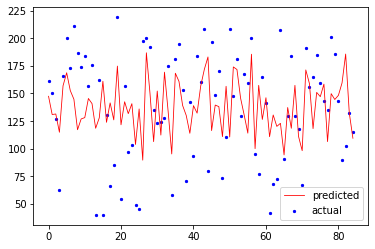

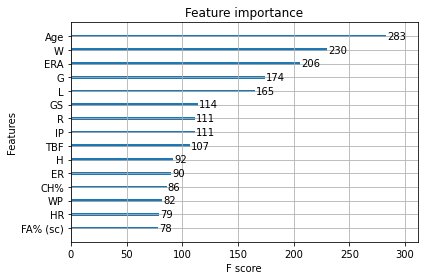

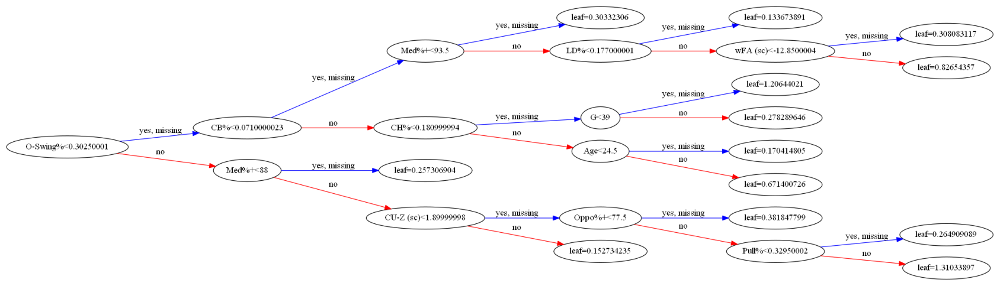

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-36.43287873212029 {'max_depth': 3}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, l

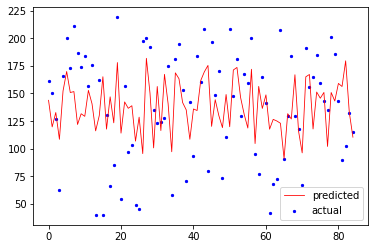

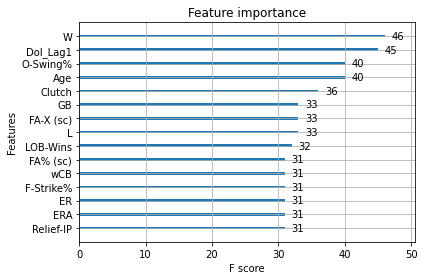

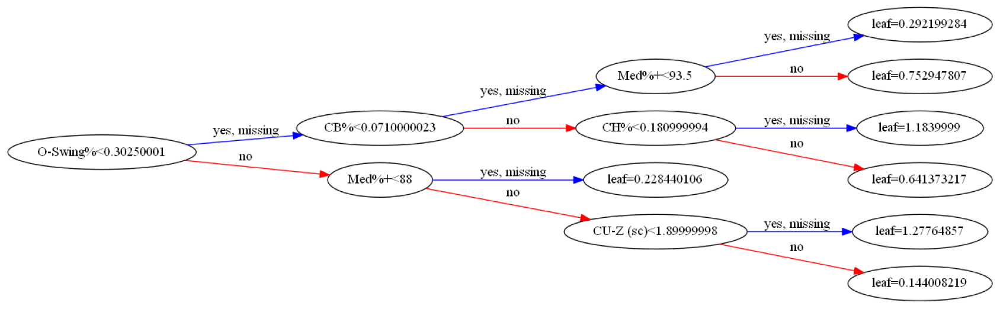

yw :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8876673371636518
Mean cross-validation score: 3.60
K-fold CV average score: 3.64
Base MAE: 3.80
Base MSE: 22.35
Base RMSE: 4.73


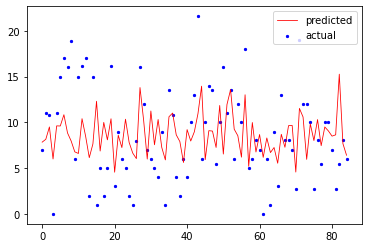

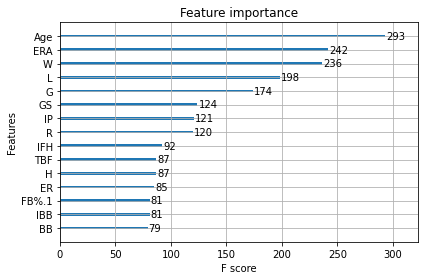

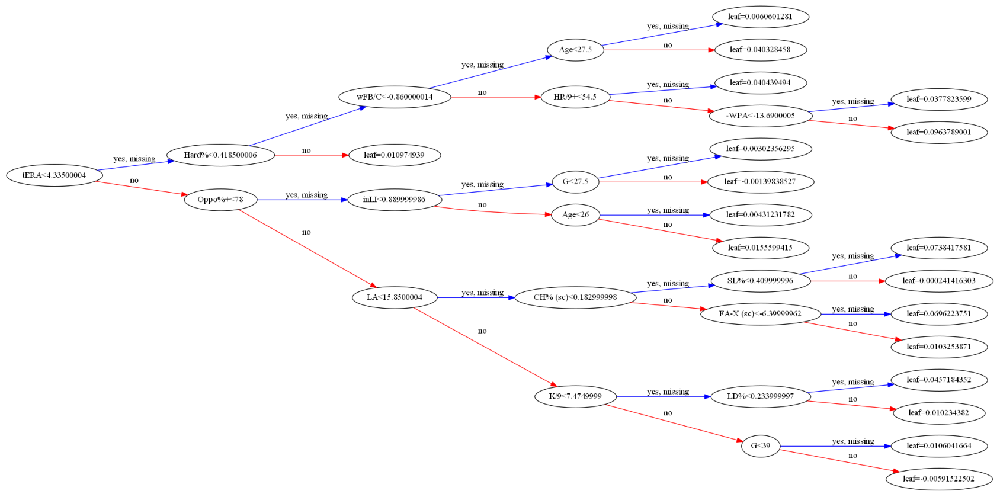

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-3.6161440387894124 {'max_depth': 8}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

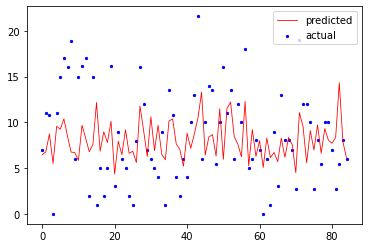

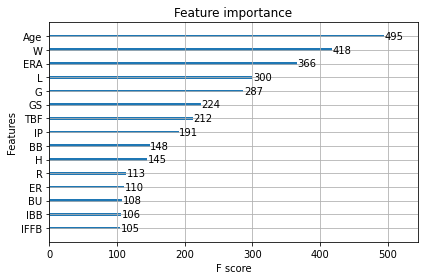

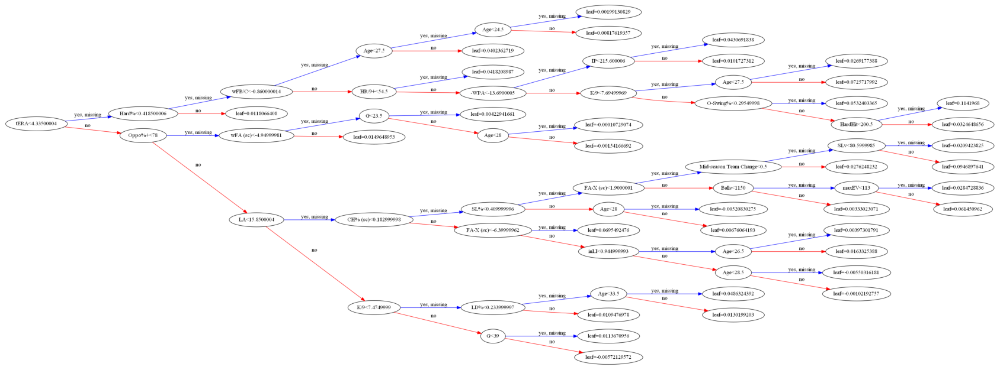

yl :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.863274557197438
Mean cross-validation score: 2.89
K-fold CV average score: 2.94
Base MAE: 2.91
Base MSE: 12.59
Base RMSE: 3.55


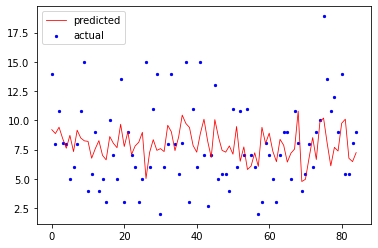

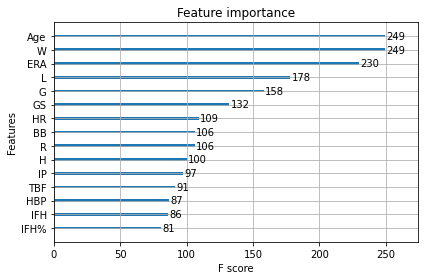

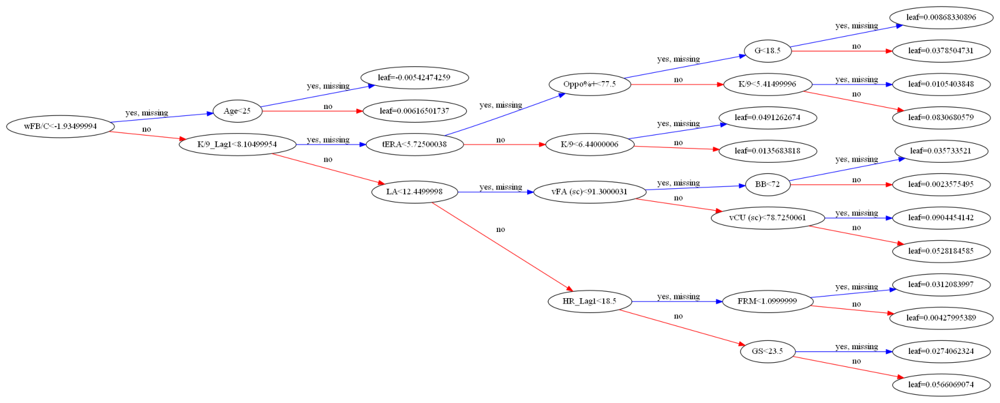

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-2.916837693803451 {'max_depth': 4}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, l

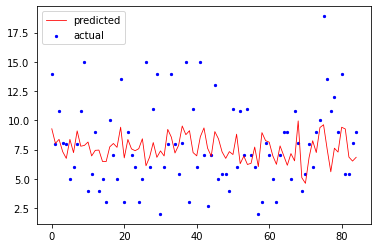

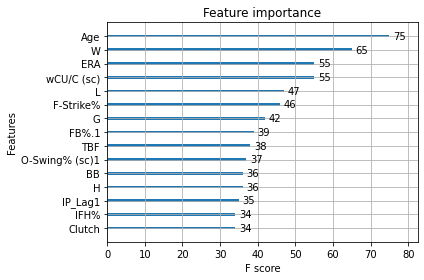

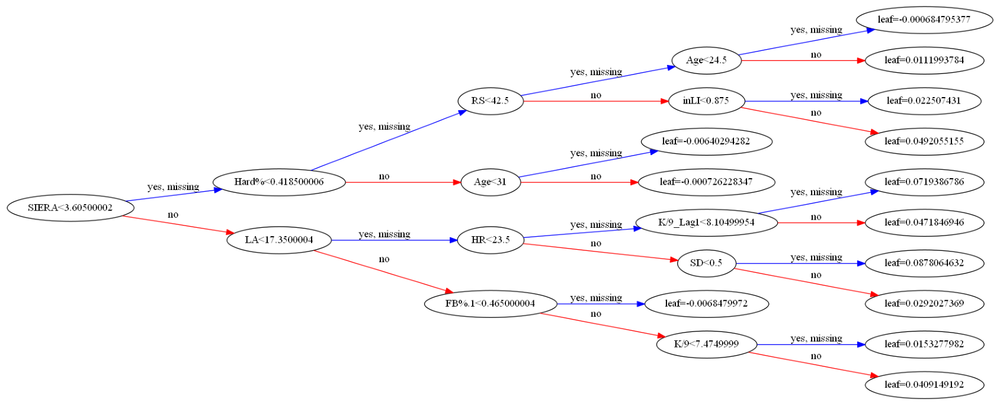

ysv :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.824241349565469
Mean cross-validation score: 0.83
K-fold CV average score: 0.85
Base MAE: 0.54
Base MSE: 0.99
Base RMSE: 0.99


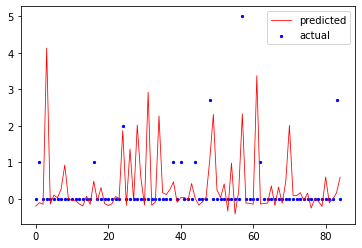

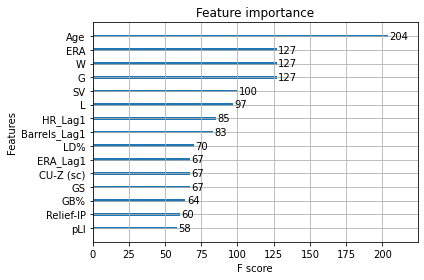

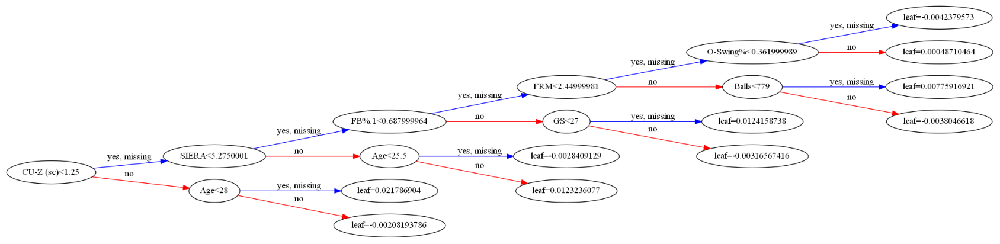

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-0.844811655663173 {'max_depth': 4}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, l

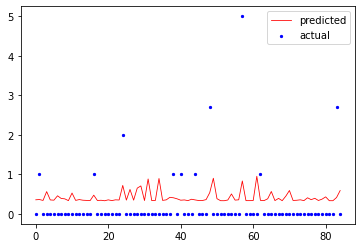

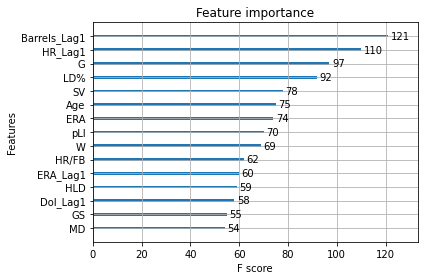

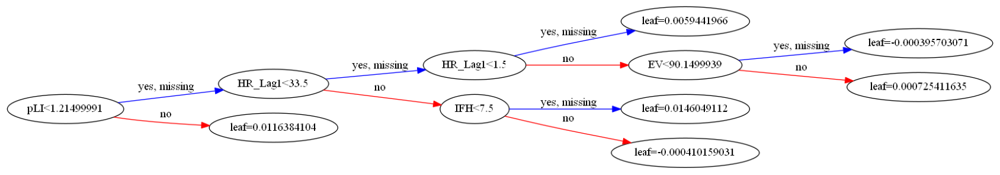

ybs :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8561191623433063
Mean cross-validation score: 0.32
K-fold CV average score: 0.34
Base MAE: 0.26
Base MSE: 0.23
Base RMSE: 0.48


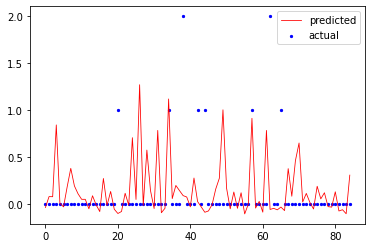

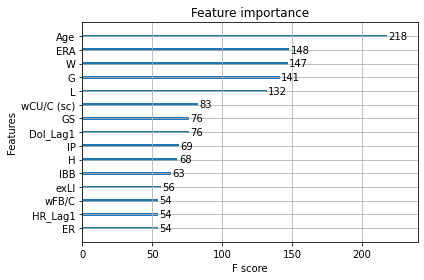

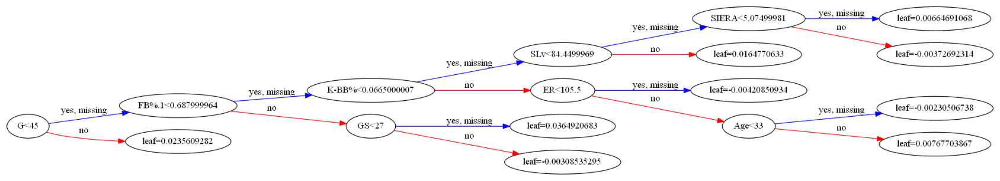

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-0.33301621764644923 {'max_depth': 3}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None,

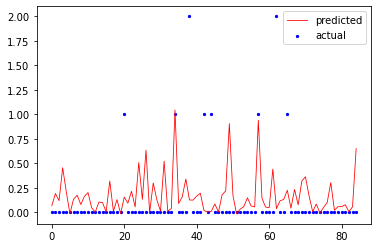

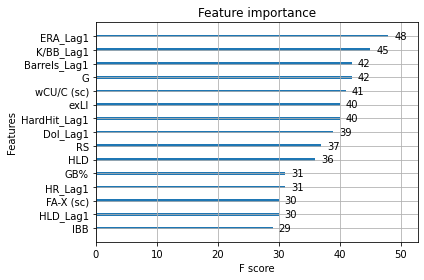

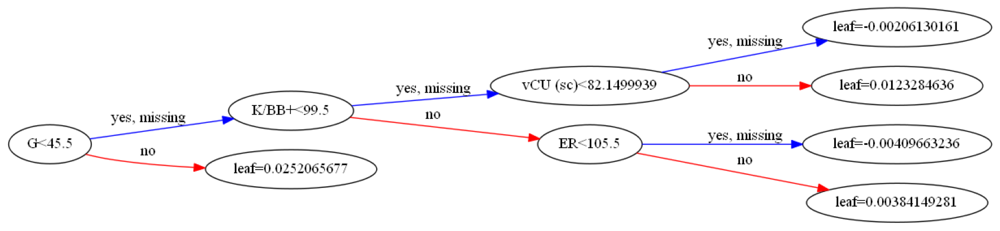

yhld :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8642797351087401
Mean cross-validation score: 1.08
K-fold CV average score: 1.11
Base MAE: 1.13
Base MSE: 6.59
Base RMSE: 2.57


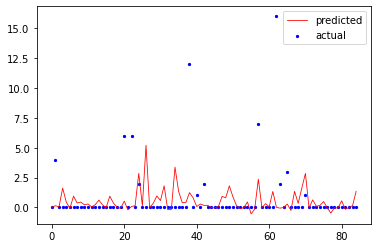

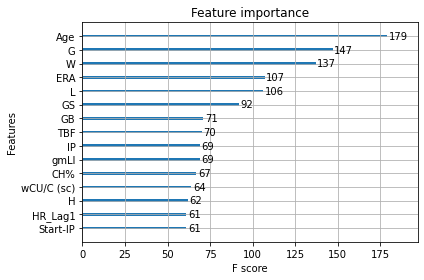

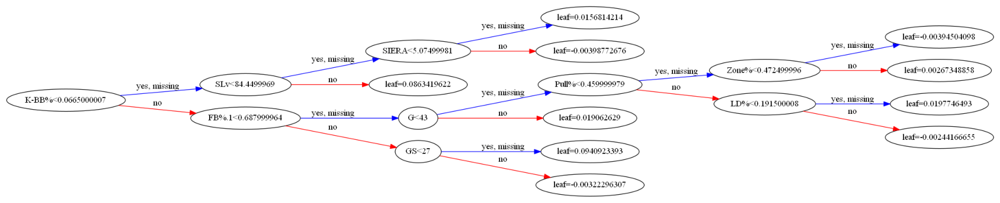

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-1.0980336637017043 {'max_depth': 3}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

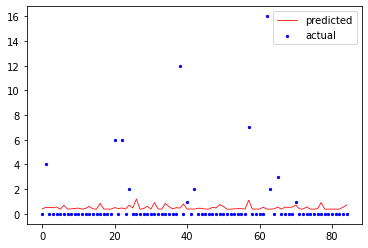

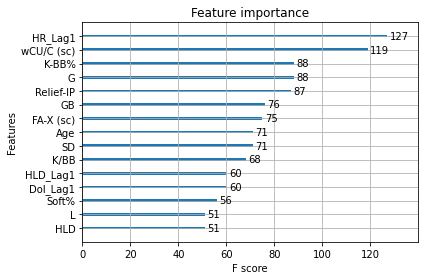

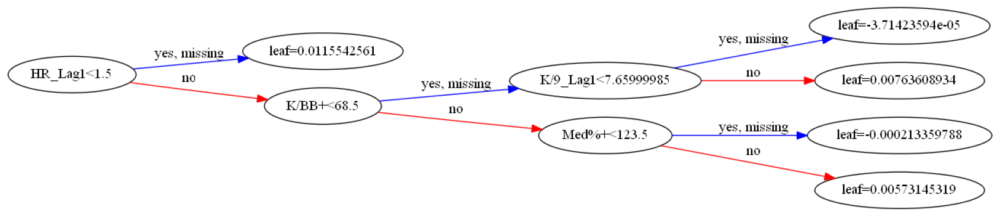

yk :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.9145335188088469
Mean cross-validation score: 39.88
K-fold CV average score: 40.15
Base MAE: 42.57
Base MSE: 2991.42
Base RMSE: 54.69


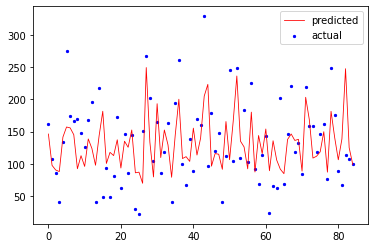

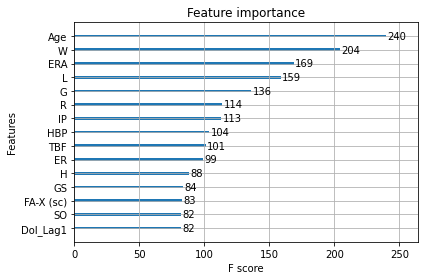

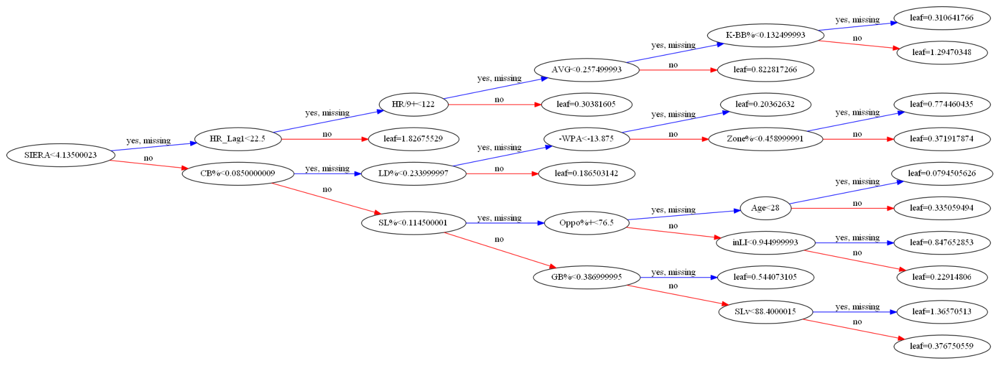

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-39.88920695136575 {'max_depth': 3}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, l

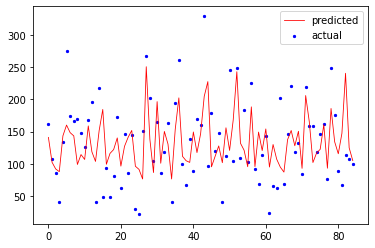

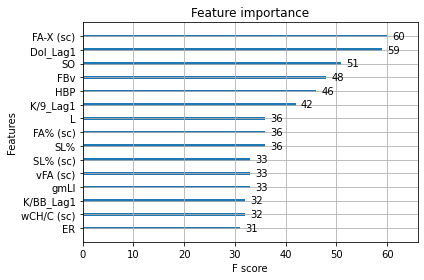

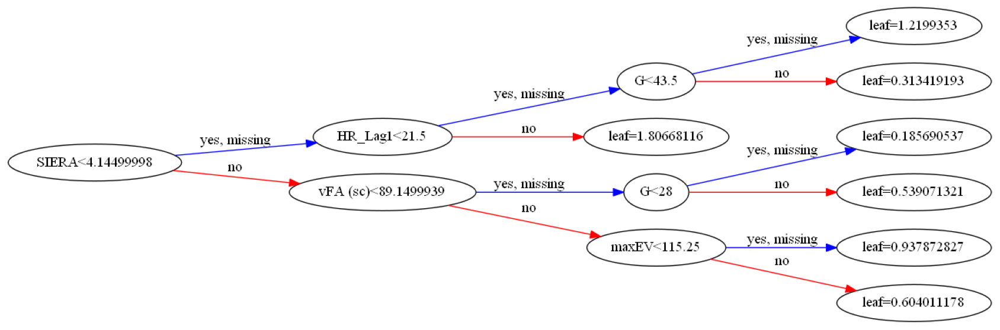

yhra :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8889191459412576
Mean cross-validation score: 6.23
K-fold CV average score: 6.13
Base MAE: 5.61
Base MSE: 47.37
Base RMSE: 6.88


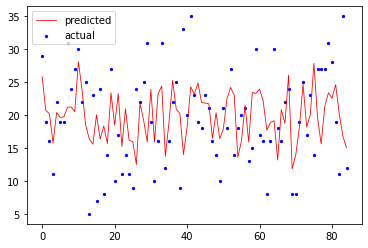

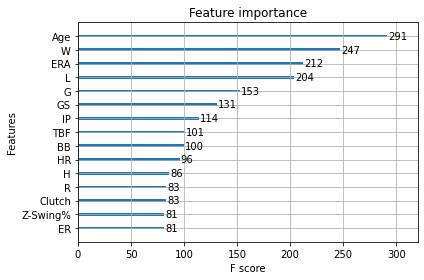

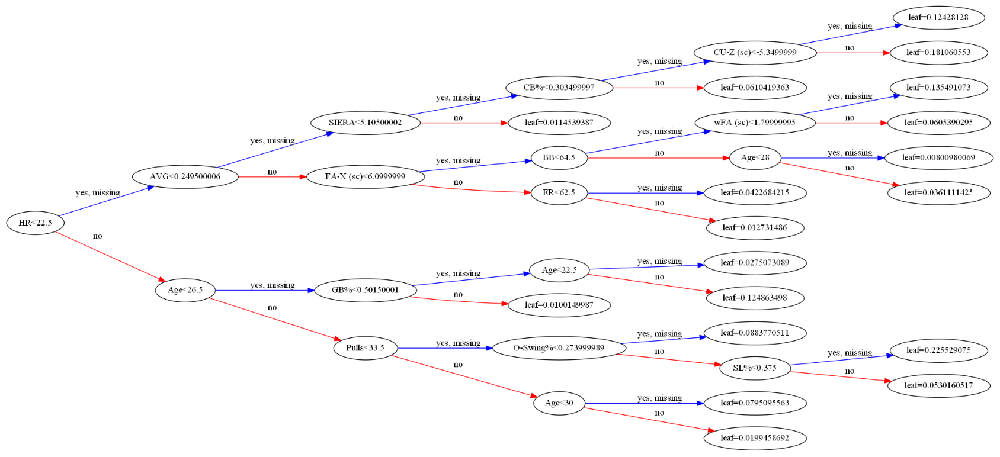

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-6.124972464056576 {'max_depth': 4}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, l

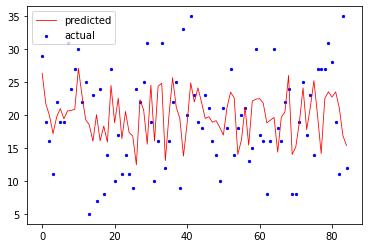

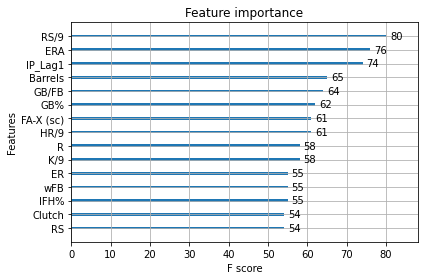

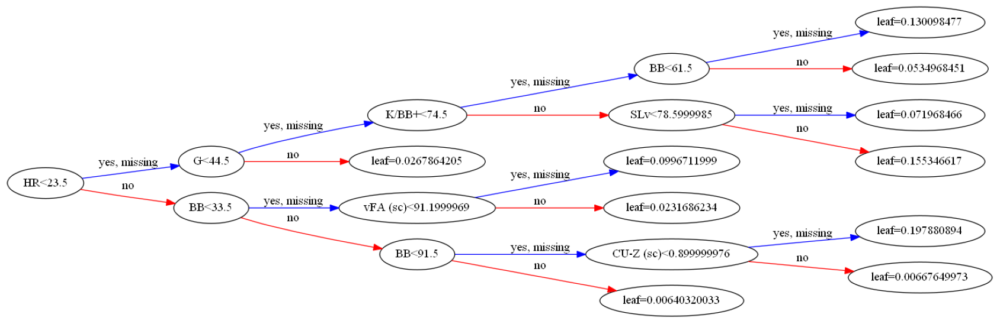

yera :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8801497571646929
Mean cross-validation score: 0.96
K-fold CV average score: 0.94
Base MAE: 0.92
Base MSE: 1.39
Base RMSE: 1.18


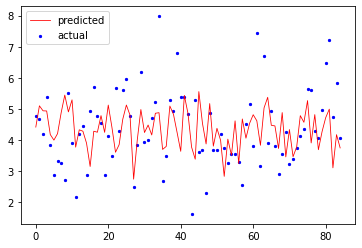

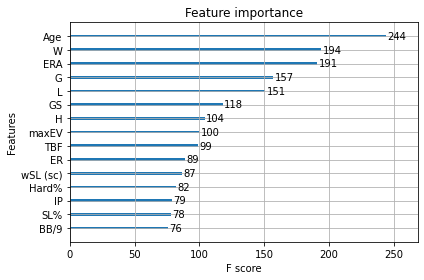

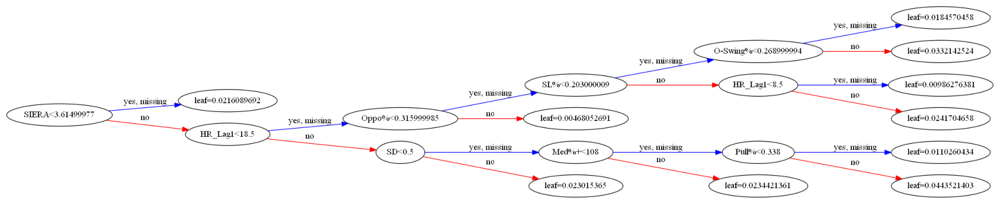

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-0.9338741919293124 {'max_depth': 3}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

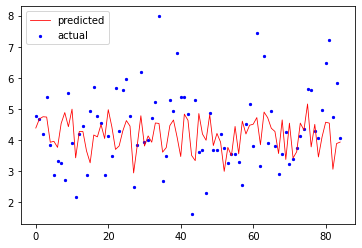

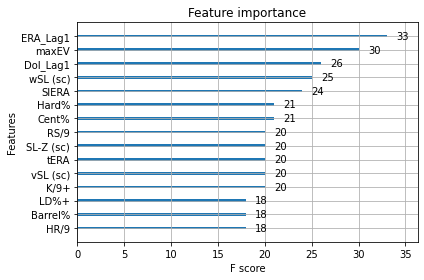

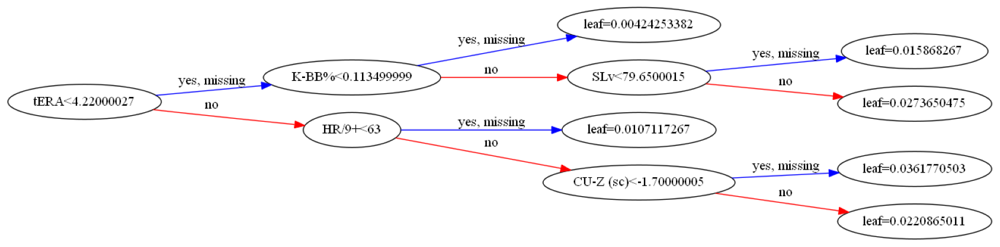

ywhip :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8882700368503212
Mean cross-validation score: 0.15
K-fold CV average score: 0.15
Base MAE: 0.14
Base MSE: 0.03
Base RMSE: 0.18


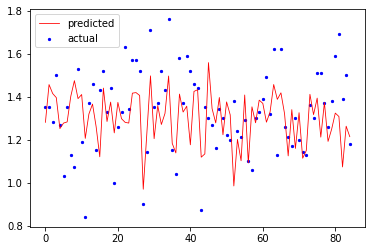

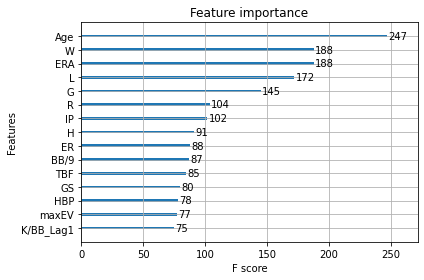

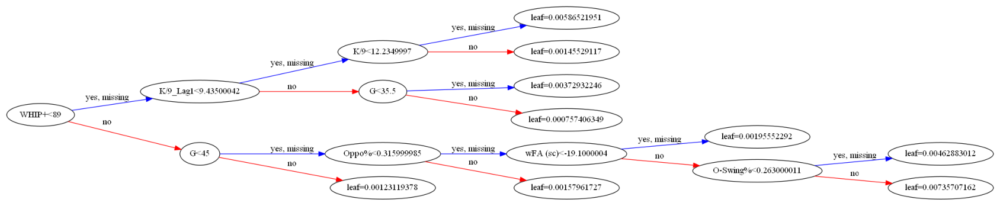

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-0.1478942100440755 {'max_depth': 3}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

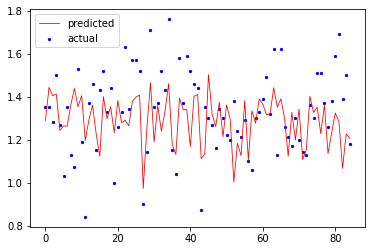

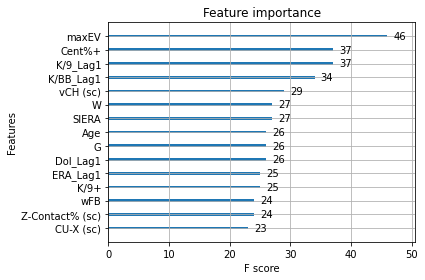

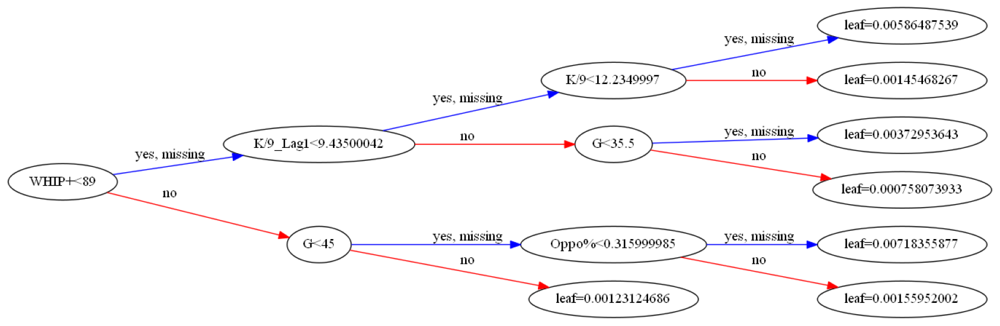

ydolp :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.9176958047047848
Mean cross-validation score: 10.58
K-fold CV average score: 10.36
Base MAE: 10.22
Base MSE: 175.58
Base RMSE: 13.25


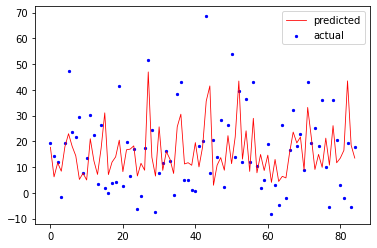

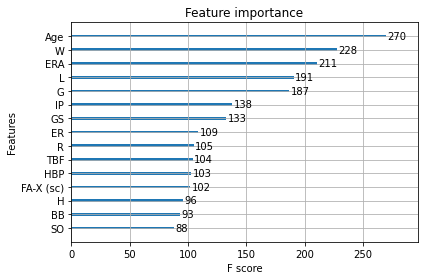

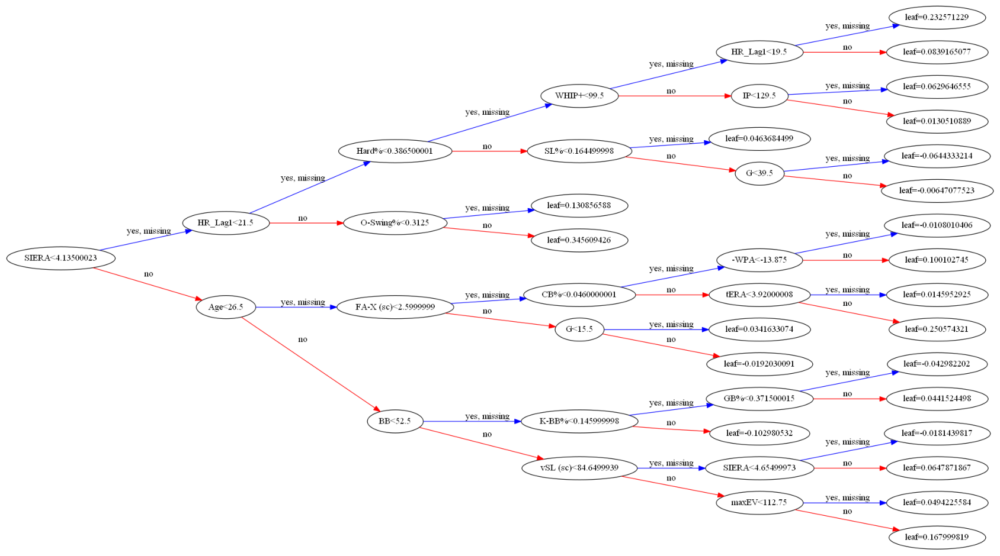

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-10.334449763010529 {'max_depth': 6}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

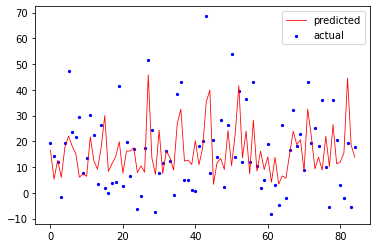

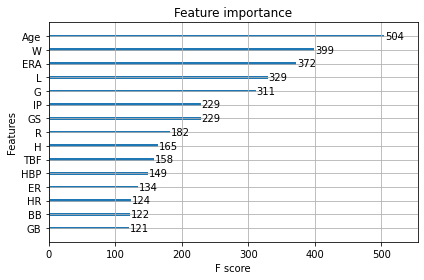

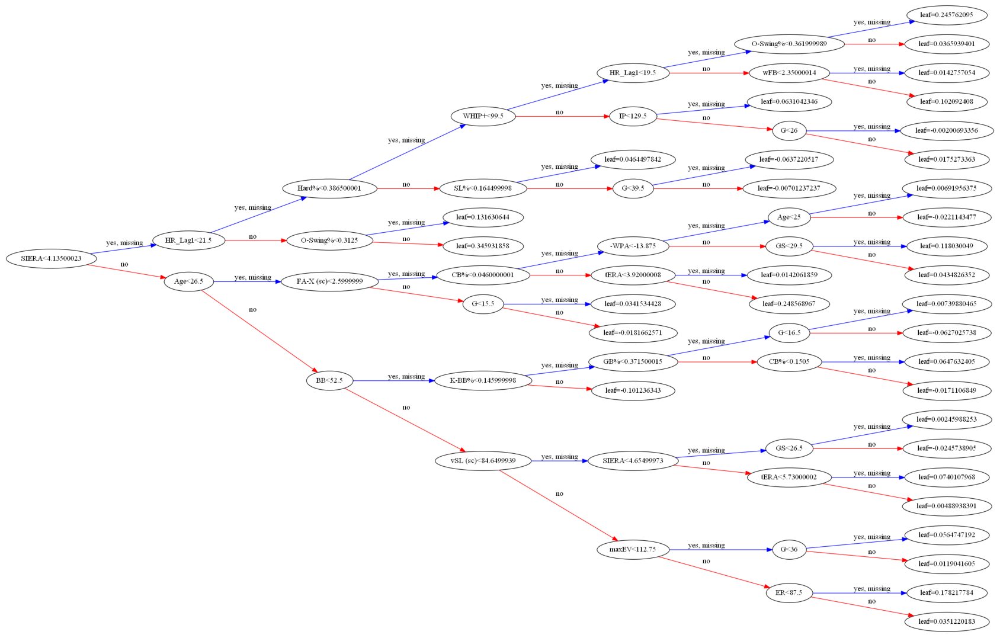

In [8]:
# Run tuning function for all target variables
for i in range(len(ys)):
    print(names[i],':')
    y = ys[i]
    xtrain, xtest, ytrain, ytest = train_test_split(X, y, test_size=0.2, random_state=RANDOMSTATE)
    tuning(xtrain, ytrain, names[i])

## Modeling Part 2: XGBoost Regression for Relief Pitchers

In [33]:
# Load 2016-19 relief pitcher data
dfrp = pd.read_csv('2016-19rp.csv')

In [34]:
# Define relief pitcher features
Xr = dfrp.drop(['playerid', 'Name', 'Team', 'League', 'Team_Traded', 'League_Traded', 'Team_Lag1', 
          'League_Lag1', 'IP_Tgt', 'W_Tgt', 'L_Tgt', 'SV_Tgt', 'BS_Tgt', 'HLD_Tgt', 'K_Tgt', 'HR_Tgt', 'ERA_Tgt', 
          'WHIP_Tgt', 'Dol_Tgt', 'IP_Tgt_Cat', 'W_Tgt_Cat', 'L_Tgt_Cat', 'SV_Tgt_Cat', 'BS_Tgt_Cat', 
          'HLD_Tgt_Cat', 'K_Tgt_Cat', 'HR_Tgt_Cat', 
          'ERA_Tgt_Cat', 'WHIP_Tgt_Cat', 'Dol_Tgt_Cat', 'IP_Tgt_Code', 'W_Tgt_Code', 'L_Tgt_Code', 'SV_Tgt_Code', 'BS_Tgt_Code', 
          'HLD_Tgt_Code', 'K_Tgt_Code', 'HR_Tgt_Code', 'ERA_Tgt_Code', 'WHIP_Tgt_Code', 'Dol_Tgt_Code', 'Year'], axis=1)
yr = dfrp['IP_Tgt']

In [35]:
# Define all relief pitcher target variables
yrip = dfrp['IP_Tgt']
yrw = dfrp['W_Tgt']
yrl = dfrp['L_Tgt']
yrsv = dfrp['SV_Tgt']
yrbs = dfrp['BS_Tgt']
yrhld = dfrp['HLD_Tgt']
yrk = dfrp['K_Tgt']
yrhra = dfrp['HR_Tgt']
yrera = dfrp['ERA_Tgt']
yrwhip = dfrp['WHIP_Tgt']
yrdolp = dfrp['Dol_Tgt']

# Define lists of target variables and names
yr = [dfrp['IP_Tgt'], dfrp['W_Tgt'], dfrp['L_Tgt'], dfrp['SV_Tgt'], dfrp['BS_Tgt'], dfrp['HLD_Tgt'], dfrp['K_Tgt'], 
      dfrp['HR_Tgt'], dfrp['ERA_Tgt'], dfrp['WHIP_Tgt'], dfrp['Dol_Tgt']]
r_names = ['yrip', 'yrw', 'yrl', 'yrsv', 'yrbs', 'yrhld', 'yrk', 'yrhra', 'yrera', 'yrwhip', 'yrdolp']

yrip :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8731824627744038
Mean cross-validation score: 10.23
K-fold CV average score: 10.36
Base MAE: 9.54
Base MSE: 173.49
Base RMSE: 13.17


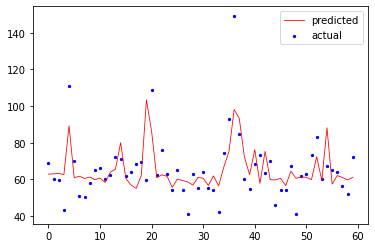

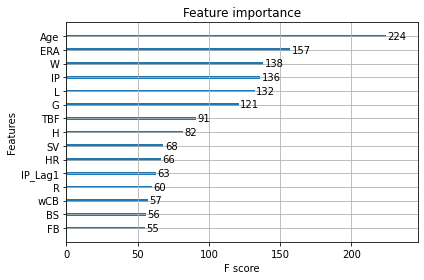

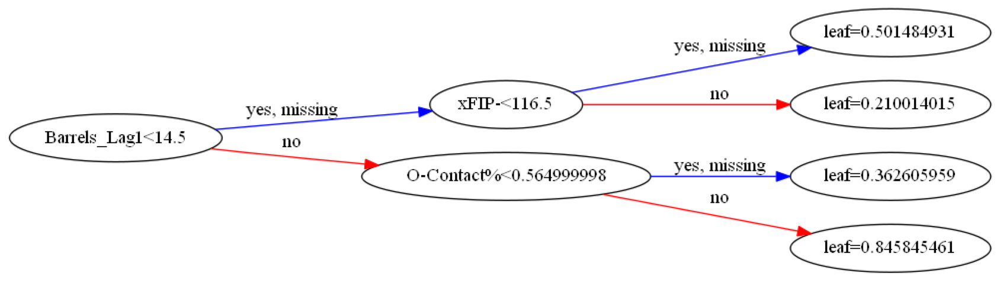

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-10.247041252772012 {'max_depth': 3}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

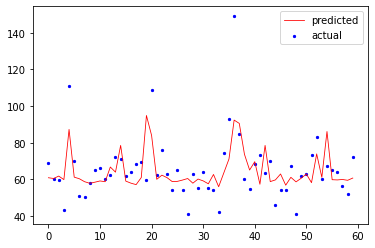

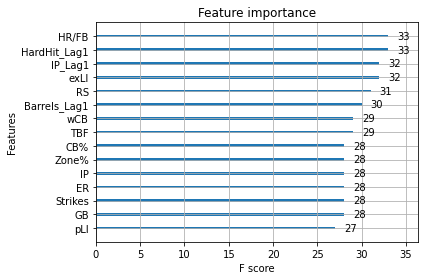

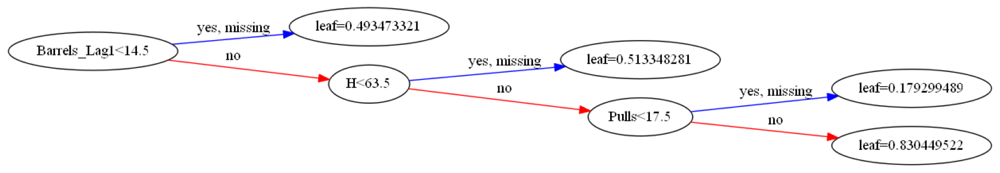

yrw :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.9013396971088116
Mean cross-validation score: 1.79
K-fold CV average score: 1.85
Base MAE: 1.75
Base MSE: 4.68
Base RMSE: 2.16


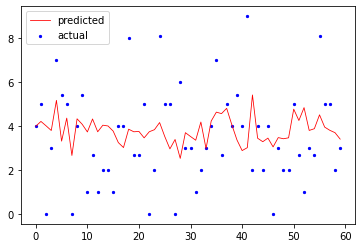

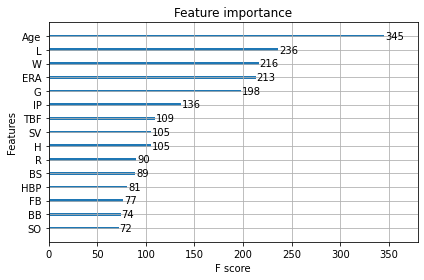

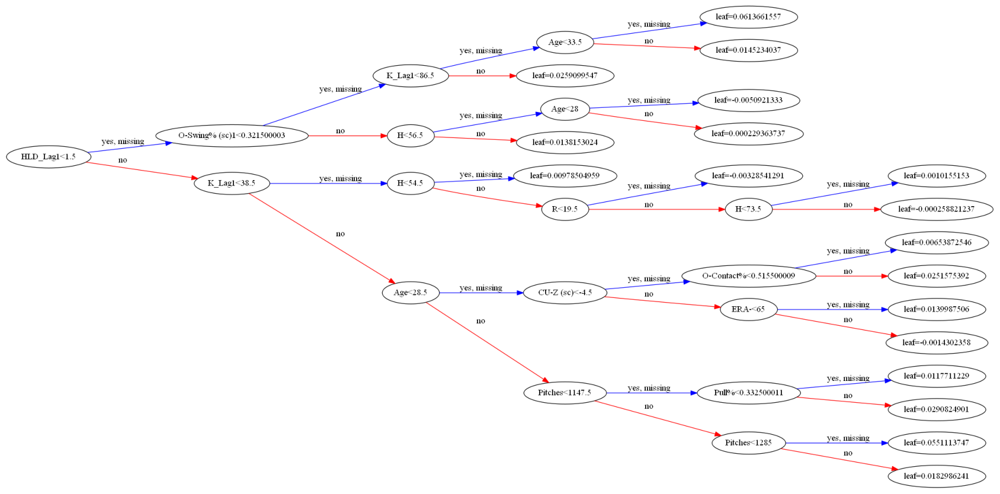

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-1.8384728993972144 {'max_depth': 7}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

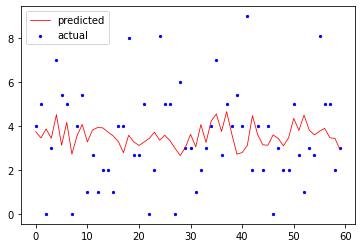

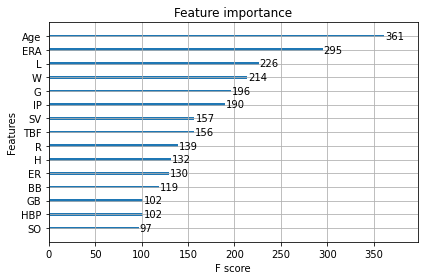

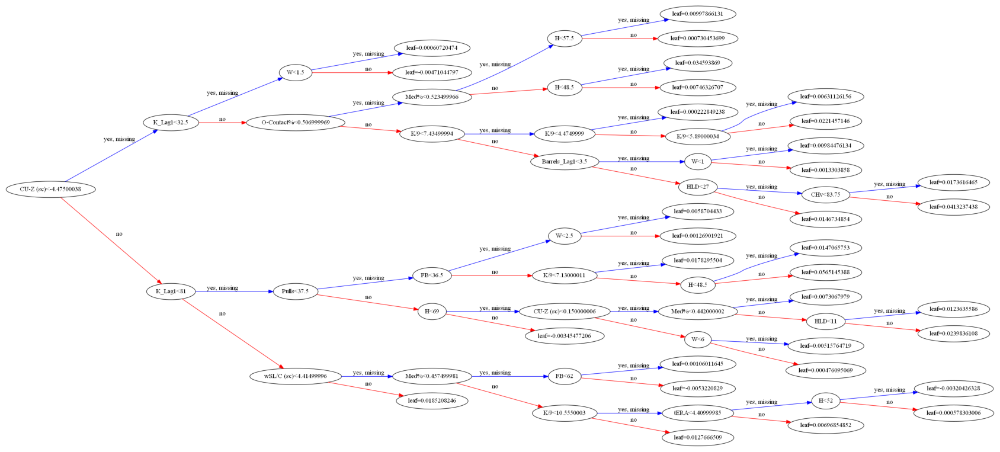

yrl :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8914477504062676
Mean cross-validation score: 1.85
K-fold CV average score: 1.85
Base MAE: 1.72
Base MSE: 5.07
Base RMSE: 2.25


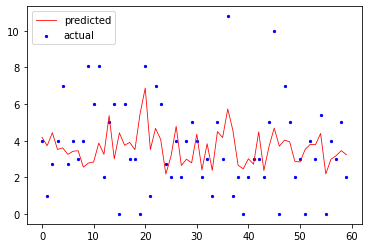

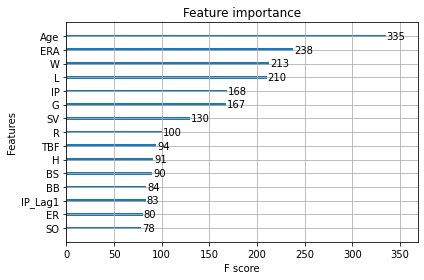

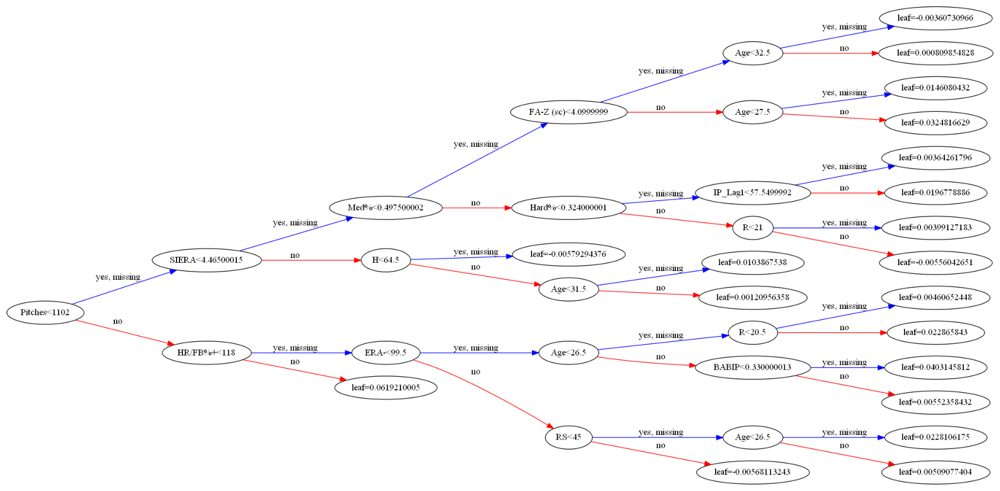

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-1.8344993419448534 {'max_depth': 6}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

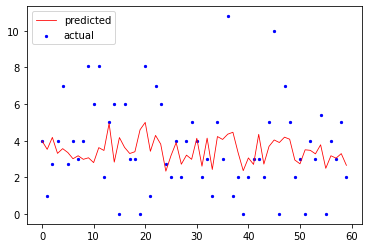

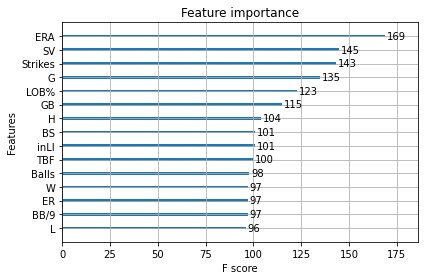

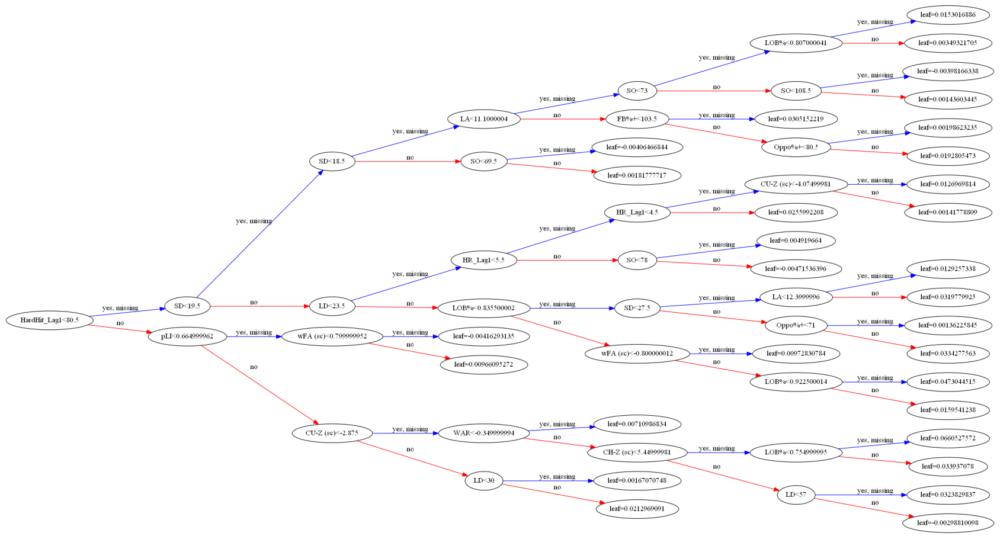

yrsv :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.9435770413765362
Mean cross-validation score: 7.53
K-fold CV average score: 7.28
Base MAE: 5.49
Base MSE: 58.33
Base RMSE: 7.64


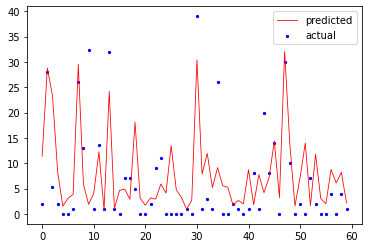

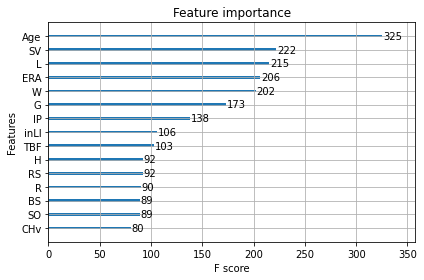

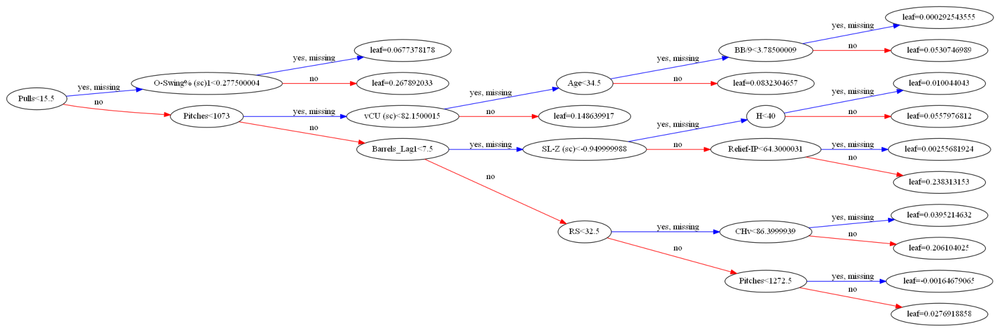

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-7.238185565769672 {'max_depth': 6}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, l

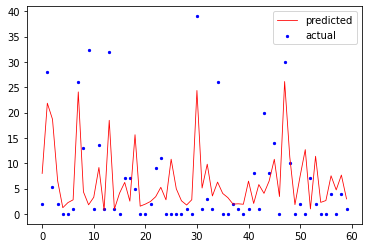

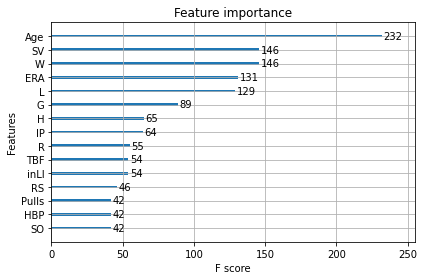

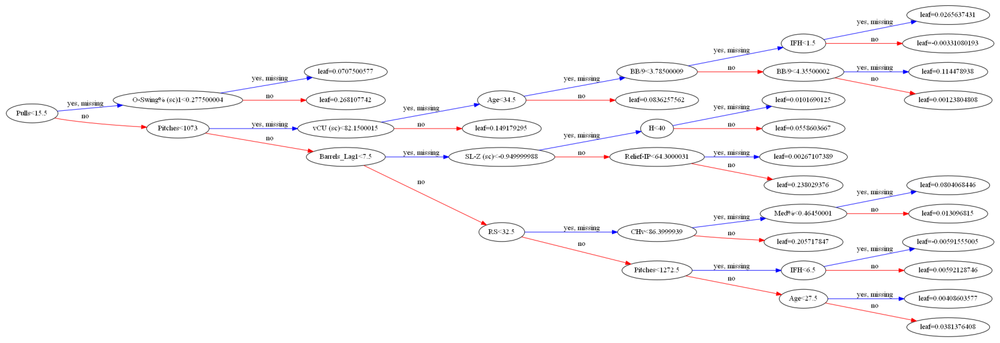

yrbs :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.898353915298608
Mean cross-validation score: 1.79
K-fold CV average score: 1.80
Base MAE: 1.95
Base MSE: 6.35
Base RMSE: 2.52


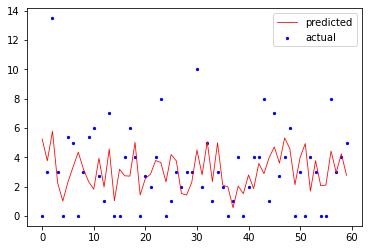

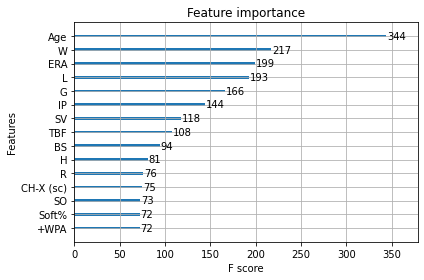

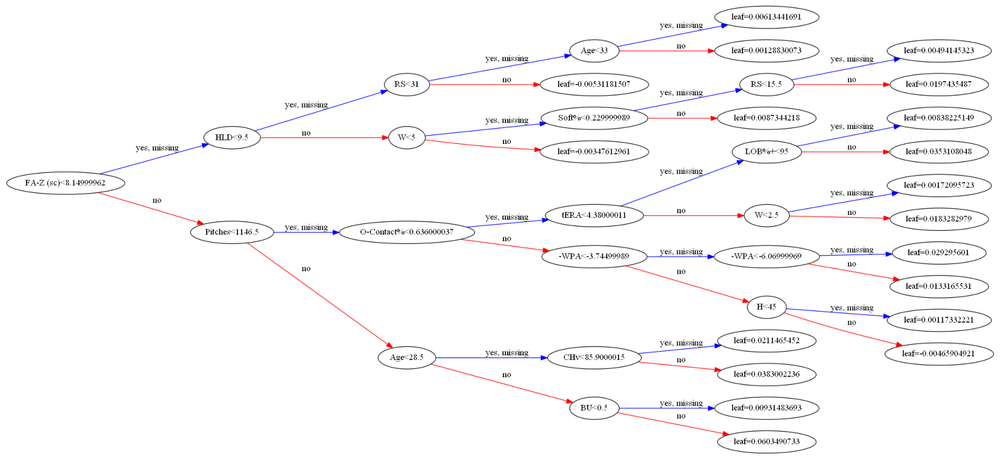

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-1.78059480180343 {'max_depth': 6}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, le

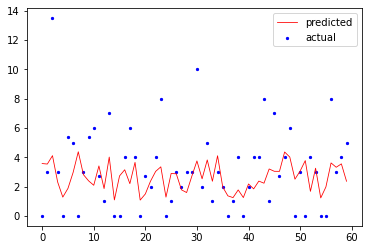

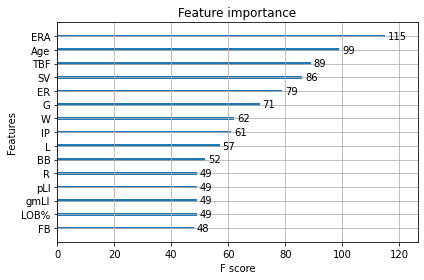

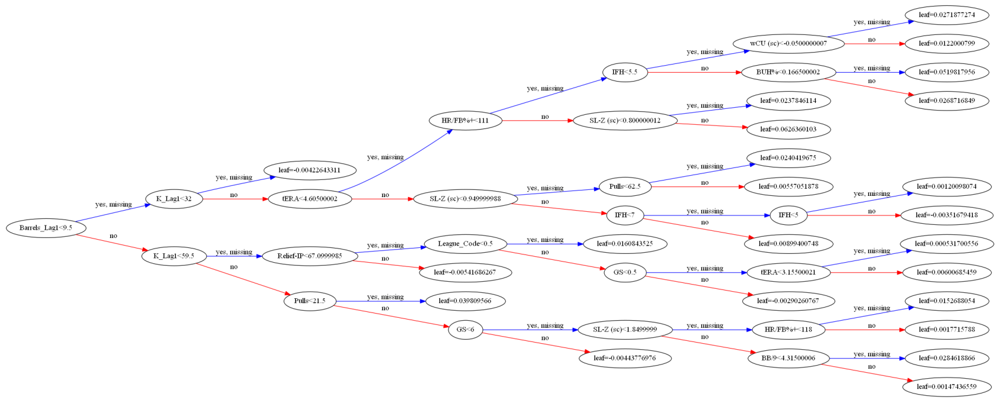

yrhld :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.9242219648321612
Mean cross-validation score: 6.23
K-fold CV average score: 6.14
Base MAE: 4.98
Base MSE: 40.04
Base RMSE: 6.33


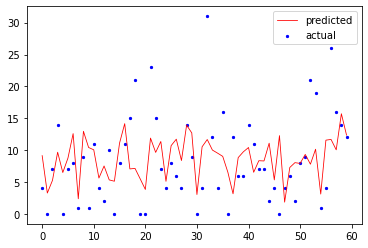

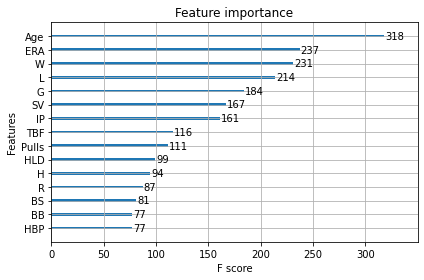

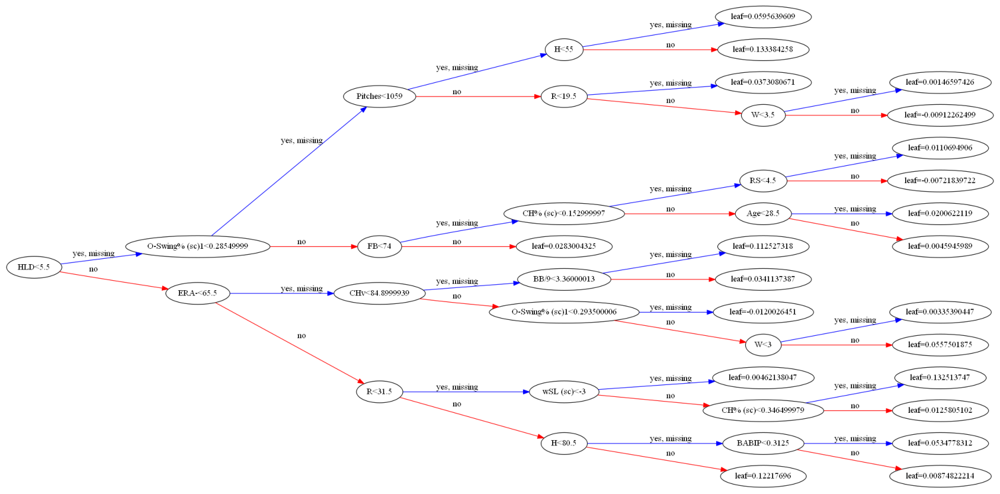

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-6.1068586875995 {'max_depth': 7}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, lea

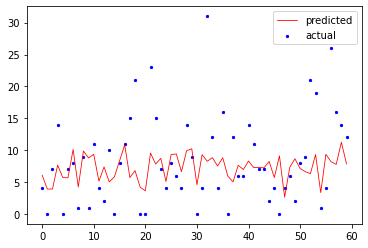

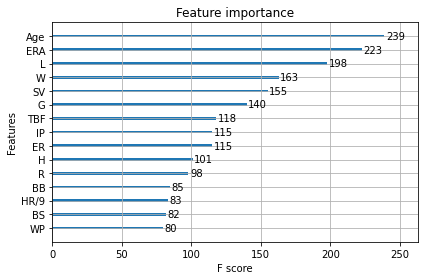

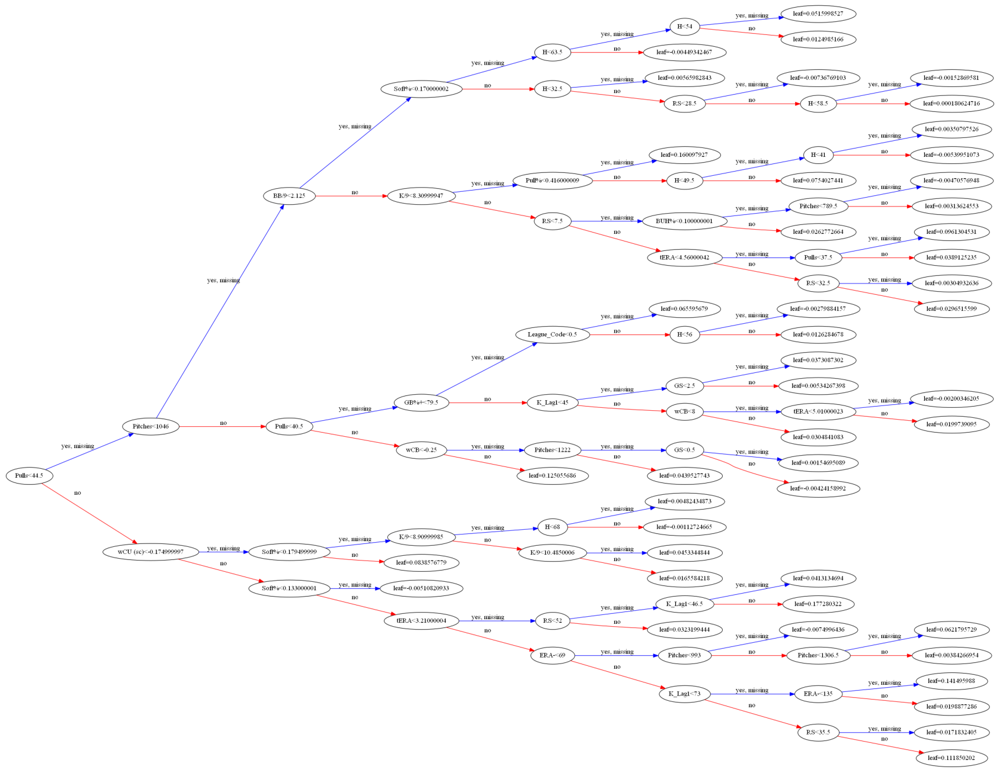

yrk :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.908761311277033
Mean cross-validation score: 15.14
K-fold CV average score: 14.95
Base MAE: 14.87
Base MSE: 345.81
Base RMSE: 18.60


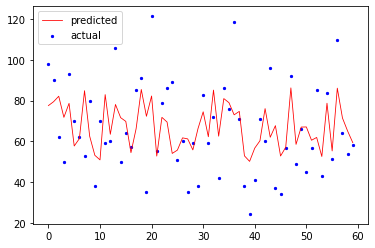

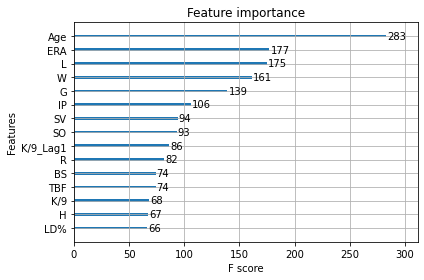

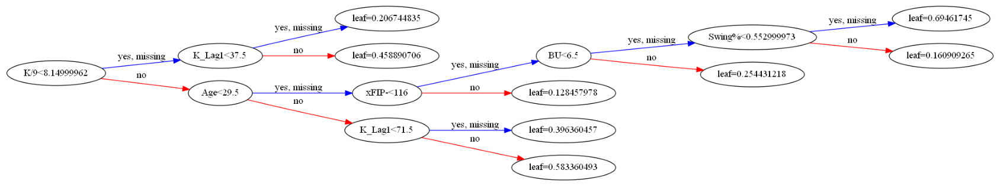

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-14.793460674285887 {'max_depth': 3}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

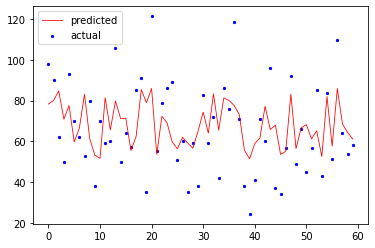

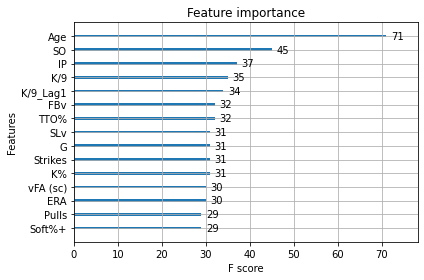

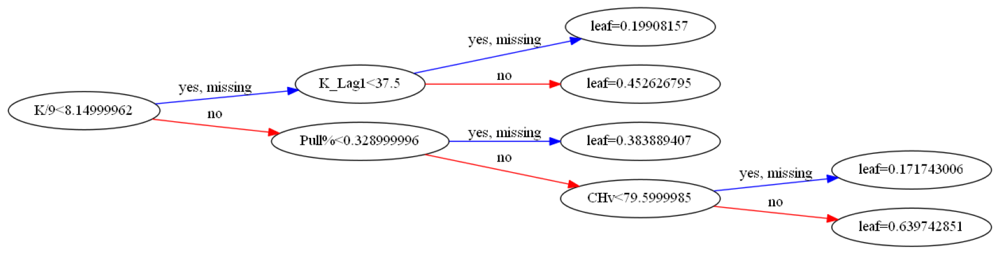

yrhra :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8986451240548865
Mean cross-validation score: 3.10
K-fold CV average score: 3.14
Base MAE: 2.94
Base MSE: 16.24
Base RMSE: 4.03


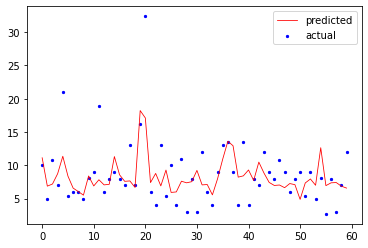

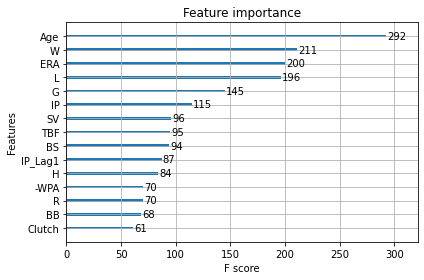

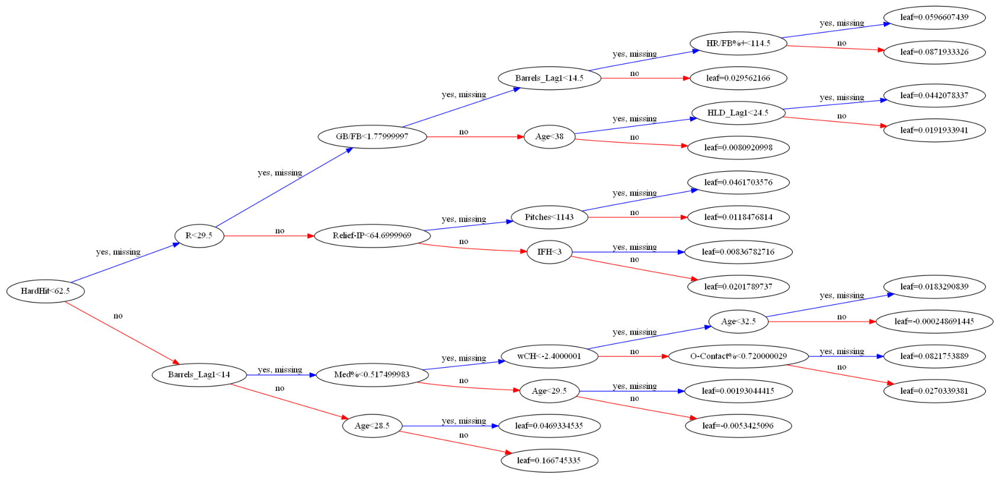

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-3.1197388076782224 {'max_depth': 8}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, 

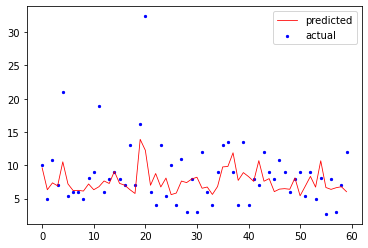

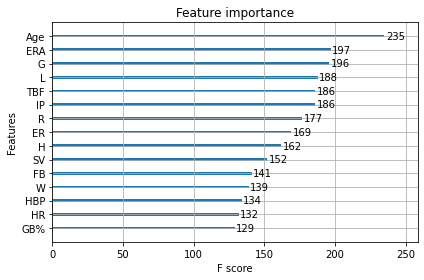

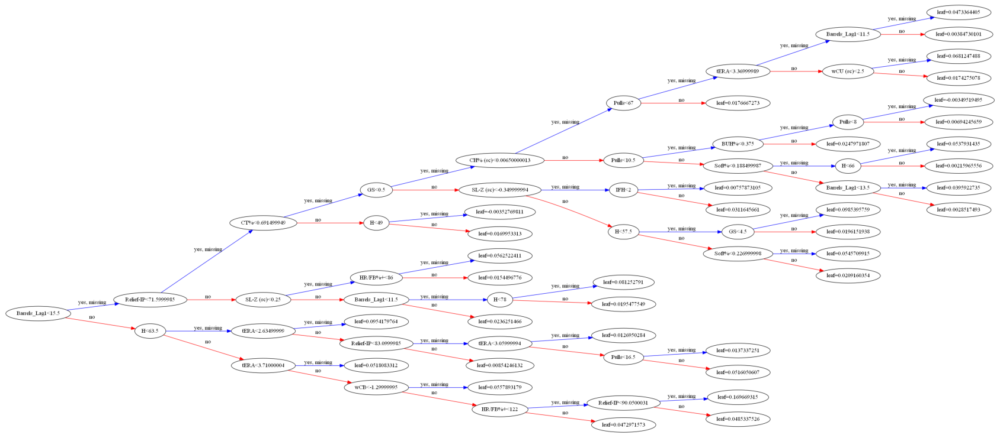

yrera :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.881317632077068
Mean cross-validation score: 1.08
K-fold CV average score: 1.04
Base MAE: 1.14
Base MSE: 1.94
Base RMSE: 1.39


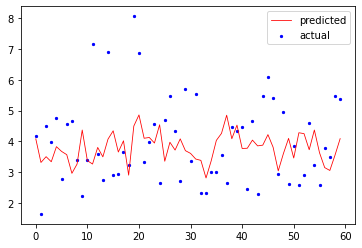

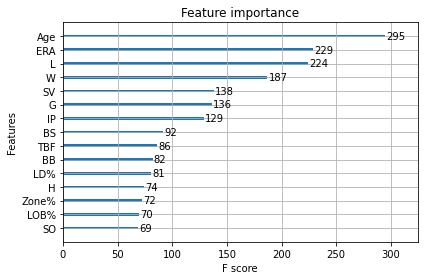

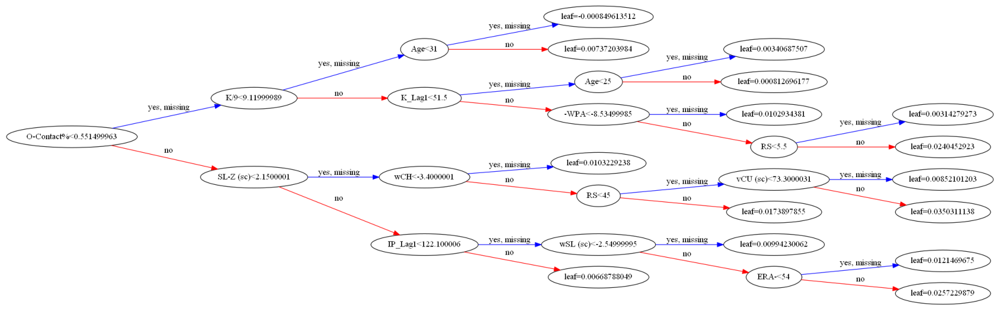

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-1.03709852707386 {'max_depth': 6}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, le

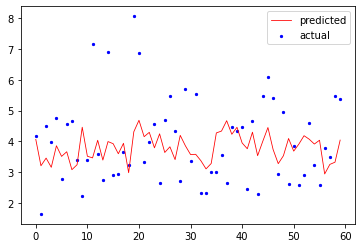

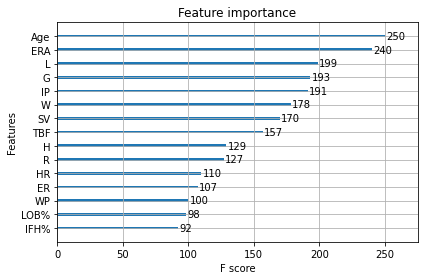

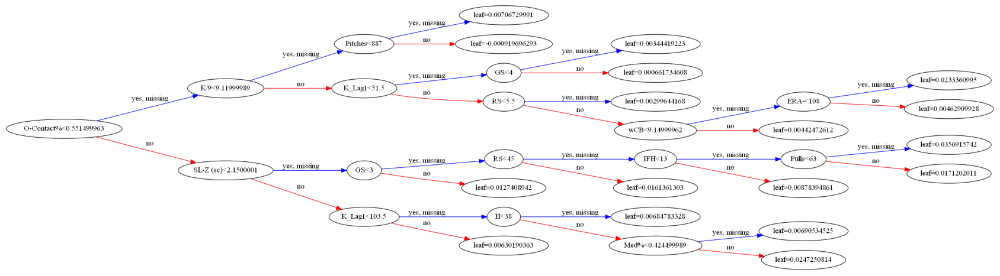

yrwhip :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.8626933829553458
Mean cross-validation score: 0.19
K-fold CV average score: 0.19
Base MAE: 0.17
Base MSE: 0.04
Base RMSE: 0.21


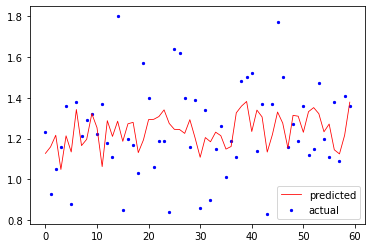

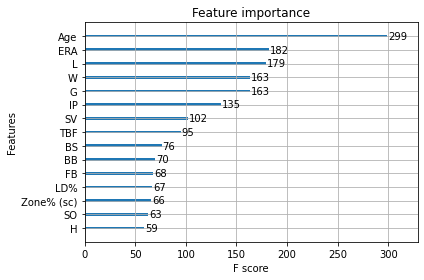

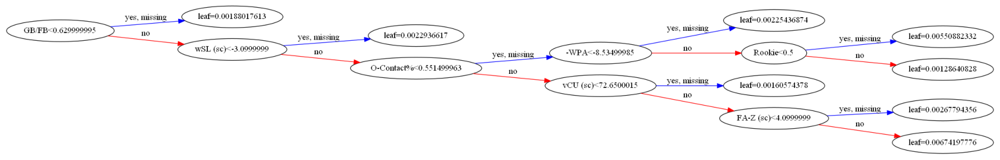

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-0.18563043640057247 {'max_depth': 7}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None,

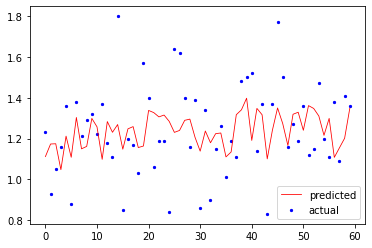

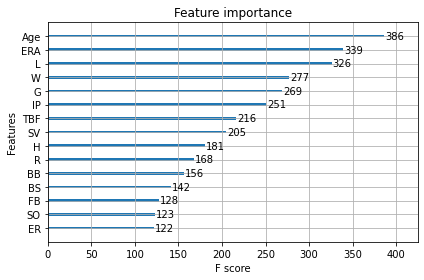

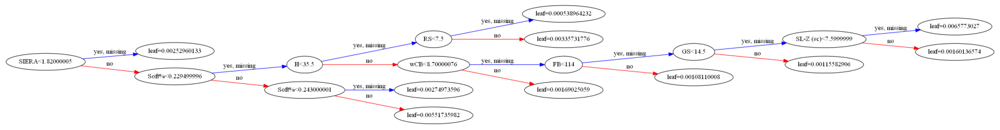

yrdolp :
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=0)
Training score:  0.902350629778397
Mean cross-validation score: 5.46
K-fold CV average score: 5.45
Base MAE: 5.48
Base MSE: 48.72
Base RMSE: 6.98


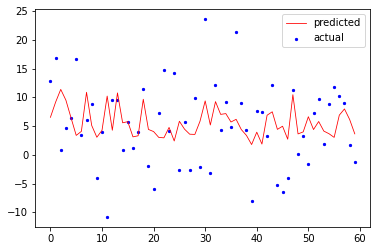

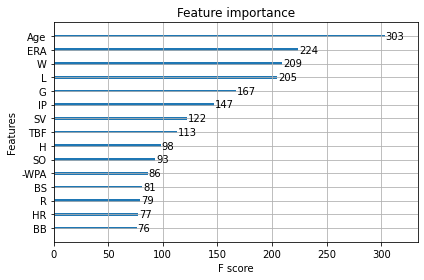

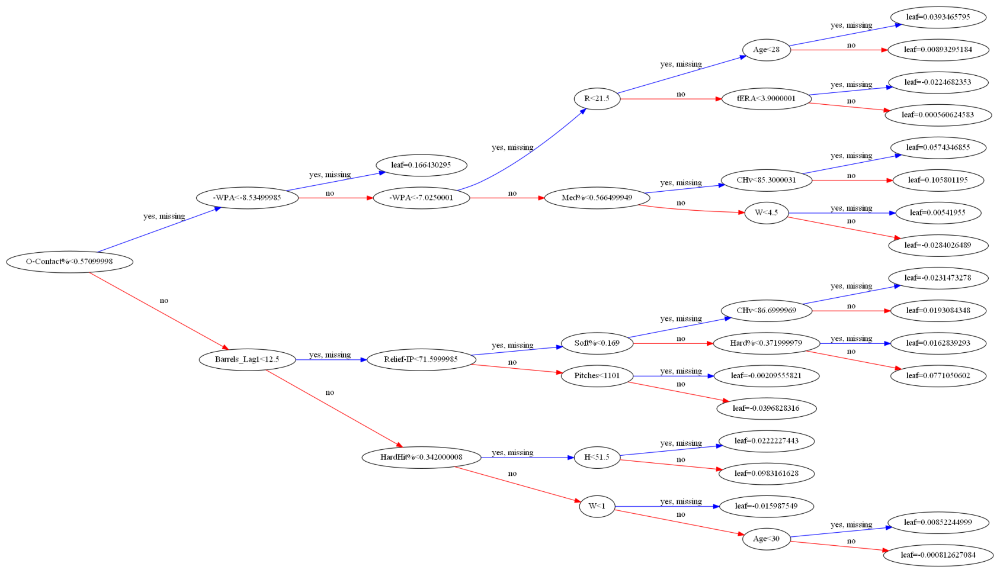

XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.01,
             max_delta_step=None, max_depth=5, min_child_weight=None,
             missing=nan, monotone_constraints=None, n_estimators=500,
             n_jobs=None, num_parallel_tree=None, random_state=None,
             reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
             subsample=0.4, tree_method=None, validate_parameters=None,
             verbosity=None)
Fitting 10 folds for each of 6 candidates, totalling 60 fits
-5.442556896507741 {'max_depth': 4}
XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=0.3, eval_metric='rmse',
             gamma=None, gpu_id=None, importance_type='gain',
             interaction_constraints=None, l

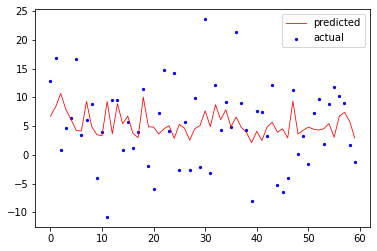

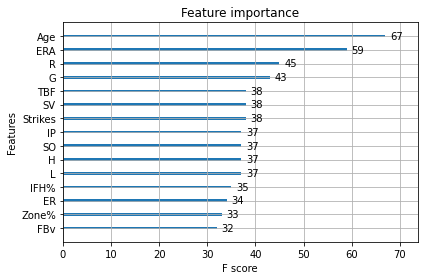

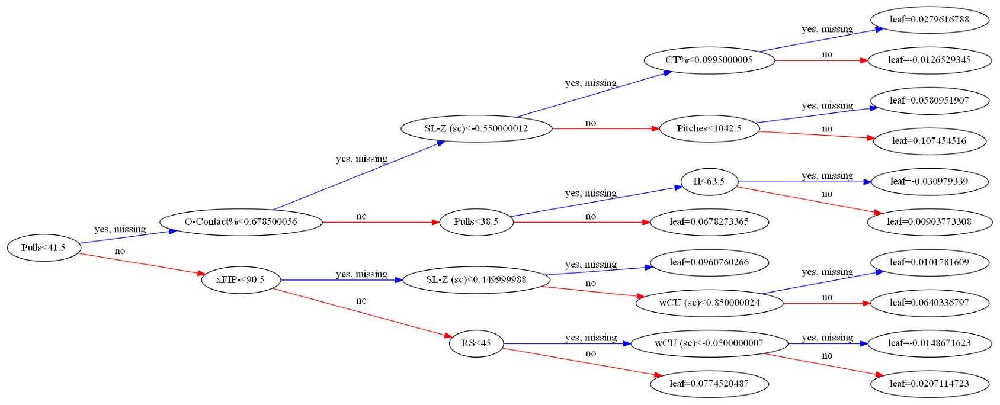

In [12]:
# Run tuning function for all relief pitcher target variables
for i in range(len(yr)):
    print(r_names[i],':')
    y = yr[i]
    xtrain, xtest, ytrain, ytest = train_test_split(Xr, y, test_size=0.2, random_state=RANDOMSTATE)
    tuning(xtrain, ytrain, r_names[i])

## Modeling Part 3: XGBoost Classification for Starting Pitchers

In [14]:
# Load 2016-19 starting pitcher dataset
dfc = pd.read_csv('2016-19sp.csv')

In [37]:
# Set feature values to 2016-19 starting pitcher dataset
Xc = dfc.drop(['playerid', 'Name', 'Team', 'League', 'Team_Traded', 'League_Traded', 'Team_Lag1', 
          'League_Lag1', 'IP_Tgt', 'W_Tgt', 'L_Tgt', 'SV_Tgt', 'BS_Tgt', 'HLD_Tgt', 'K_Tgt', 'HR_Tgt', 'ERA_Tgt', 
          'WHIP_Tgt', 'Dol_Tgt', 'IP_Tgt_Cat', 'W_Tgt_Cat', 'L_Tgt_Cat', 'SV_Tgt_Cat', 'BS_Tgt_Cat', 
          'HLD_Tgt_Cat', 'K_Tgt_Cat', 'HR_Tgt_Cat', 
          'ERA_Tgt_Cat', 'WHIP_Tgt_Cat', 'Dol_Tgt_Cat', 'IP_Tgt_Code', 'W_Tgt_Code', 'L_Tgt_Code', 'SV_Tgt_Code', 'BS_Tgt_Code', 
          'HLD_Tgt_Code', 'K_Tgt_Code', 'HR_Tgt_Code', 'ERA_Tgt_Code', 'WHIP_Tgt_Code', 'Dol_Tgt_Code'], axis=1)

# Define target variables - omit saves, blown saves, and holds at this stage - we will set those to zero for SP
yc = dfc['IP_Tgt_Code']
yipc = dfc['IP_Tgt_Code']
ywc = dfc['W_Tgt_Code']
ylc = dfc['L_Tgt_Code']
ykc = dfc['K_Tgt_Code']
yhrac = dfc['HR_Tgt_Code']
yerac = dfc['ERA_Tgt_Code']
ywhipc = dfc['WHIP_Tgt_Code']
ydolpc = dfc['Dol_Tgt_Code']

# Build lists of target variables and names
ycs = [dfc['IP_Tgt_Code'], dfc['W_Tgt_Code'], dfc['L_Tgt_Code'],
      dfc['K_Tgt_Code'], dfc['HR_Tgt_Code'], dfc['ERA_Tgt_Code'], dfc['WHIP_Tgt_Code'], dfc['Dol_Tgt_Code']]
names = ['yipc', 'ywc', 'ylc', 'ykc', 'yhrac', 'yerac', 'ywhipc', 'ydolpc']

In [39]:
def clf_tuning(xtrain, ytrain, name, kfold):
    """Function to build XGBoost classifier models and tune hyperparameters in multiple steps."""
    
    # Reset default hyperparameters
    param_dict = {'n_estimators':500, 'learning_rate':0.01, 'max_depth':5, 
                  'subsample':0.4, 'colsample_bytree':0.3}
    
    # Define and train base model
    base_model = xgb.XGBClassifier(eval_metric='merror', **param_dict, verbosity=0, use_label_encoder=False)
    
    print(base_model)

    base_model.fit(xtrain, ytrain)

    score = base_model.score(xtrain, ytrain)   
    print("Training score: ", score) 

    # Cross-validataion 
    
    # Construct pipeline to run SMOTE oversampling for each fold of cross-validation
    imb_pipeline = make_pipeline(SMOTE(random_state=RANDOMSTATE), 
                              xgb.XGBClassifier(eval_metric='merror', **param_dict, verbosity=0, use_label_encoder=False))
    
    scores = cross_val_score(imb_pipeline, xtrain, ytrain, scoring='f1_micro', cv=5)
    print("Mean cross-validation score: %.2f" % scores.mean())

    kf_cv_scores = cross_val_score(imb_pipeline, xtrain, ytrain, scoring='f1_micro', cv=kfold)
    print("K-fold CV average score: %.2f" % kf_cv_scores.mean())

    # Predict test set using base model
    base_ypred = base_model.predict(xtest)
    base_precision = precision_score(ytest, base_ypred, average='weighted')
    base_recall = recall_score(ytest, base_ypred, average='weighted')
    print("Precision: %.2f%%" % (base_precision * 100.0))
    print("Recall: %.2f%%" % (base_recall * 100.0))

    # Define outlier precision and recall measures to exclude non-outlier values
    base_outlier_precision = precision_score(ytest[ytest!=1], base_ypred[ytest!=1], average='weighted')
    base_outlier_recall = recall_score(ytest[ytest!=1], base_ypred[ytest!=1], average='weighted')
    print("Outlier Precision: %.2f%%" % (base_outlier_precision * 100.0))
    print("Outlier Recall: %.2f%%" % (base_outlier_recall * 100.0))

    # Plot model performance
    x_ax = range(len(ytest))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="actual")
    plt.plot(x_ax, base_ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()

    # Display and save feature importance chart
    xgb.plot_importance(base_model, max_num_features = 15)
    plt.tight_layout()
    plt.savefig('base_clf_'+name+'_1619.png')
    plt.show()

    # Hyperparameter grid search step 1: max depth
    param_dict = {'xgbclassifier__n_estimators':500, 'xgbclassifier__learning_rate':0.01, 'xgbclassifier__max_depth':5, 
                  'xgbclassifier__subsample':0.1, 'xgbclassifier__colsample_bytree':0.3}
    
    model = make_pipeline(SMOTE(random_state=RANDOMSTATE), 
                           xgb.XGBClassifier(eval_metric='merror', **param_dict, verbosity=0, use_label_encoder=False))
    print(model)
    max_depth = range(3, 9, 1)
    param_grid = dict(xgbclassifier__max_depth=max_depth)
    grid_search = GridSearchCV(model, param_grid, scoring='f1_micro', n_jobs=-1, cv=kfold, verbose=1)
    grid_result = grid_search.fit(xtrain, ytrain)
    param_dict['xgbclassifier__max_depth'] = grid_result.best_params_['xgbclassifier__max_depth']
    print(grid_result.best_score_, grid_result.best_params_)

    # Hyperparameter grid search step 2: subsample, colsample_bytree
    model2 = make_pipeline(SMOTE(random_state=RANDOMSTATE), 
                           xgb.XGBClassifier(eval_metric='merror', **param_dict, verbosity=0, use_label_encoder=False))
    print(model2)
    subsample = np.linspace(0.4, 1.0, 7)
    colsample_bytree = np.linspace(0.1, 0.35, 6)
    param_grid = dict(xgbclassifier__subsample=subsample, xgbclassifier__colsample_bytree=colsample_bytree, 
                      xgbclassifier__max_depth=[grid_result.best_params_['xgbclassifier__max_depth']])
    grid_search = GridSearchCV(model2, param_grid, scoring='f1_micro', n_jobs=-1, cv=kfold, return_train_score=True, verbose=1)
    grid_result = grid_search.fit(xtrain, ytrain)
    param_dict['xgbclassifier__subsample'] = grid_result.best_params_['xgbclassifier__subsample']
    param_dict['xgbclassifier__colsample_bytree'] = grid_result.best_params_['xgbclassifier__colsample_bytree']
    print(grid_result.best_score_, grid_result.best_params_)

    # Hyperparameter grid search step 3: learning rate
    model3 = make_pipeline(SMOTE(random_state=RANDOMSTATE), 
                           xgb.XGBClassifier(eval_metric='merror', **param_dict, verbosity=0, use_label_encoder=False))
    print(model3)
    learning_rate = [0.0001, 0.001, 0.01, 0.1]
    param_grid = dict(xgbclassifier__learning_rate=learning_rate, 
                      xgbclassifier__subsample=[grid_result.best_params_['xgbclassifier__subsample']], 
                      xgbclassifier__colsample_bytree=[grid_result.best_params_['xgbclassifier__colsample_bytree']], 
                      xgbclassifier__max_depth=[grid_result.best_params_['xgbclassifier__max_depth']])
    grid_search = GridSearchCV(model3, param_grid, scoring='f1_micro', n_jobs=-1, cv=kfold, return_train_score=True, verbose=1)
    grid_result = grid_search.fit(xtrain, ytrain)
    param_dict['xgbclassifier__learning_rate'] = grid_result.best_params_['xgbclassifier__learning_rate']
    print(grid_result.best_score_, grid_result.best_params_)

    # Hyperparameter grid search step 4: number of estimators
    model4 = make_pipeline(SMOTE(random_state=RANDOMSTATE), 
                           xgb.XGBClassifier(eval_metric='merror', **param_dict, verbosity=0, use_label_encoder=False))
    print(model4)
    n_estimators = [100, 200, 300, 400, 500]
    param_grid = dict(xgbclassifier__n_estimators=n_estimators, 
                      xgbclassifier__learning_rate=[grid_result.best_params_['xgbclassifier__learning_rate']], 
                      xgbclassifier__subsample=[grid_result.best_params_['xgbclassifier__subsample']], 
                      xgbclassifier__colsample_bytree=[grid_result.best_params_['xgbclassifier__colsample_bytree']], 
                      xgbclassifier__max_depth=[grid_result.best_params_['xgbclassifier__max_depth']])
    grid_search = GridSearchCV(model4, param_grid, scoring='f1_micro', n_jobs=-1, cv=kfold, return_train_score=True, verbose=1)
    grid_result = grid_search.fit(xtrain, ytrain)
    param_dict['xgbclassifier__n_estimators'] = grid_result.best_params_['xgbclassifier__n_estimators']
    best_params_list.append(param_dict)
    print(grid_result.best_score_, grid_result.best_params_)
    
    # Train best parameter model    
    model5 = make_pipeline(SMOTE(random_state=RANDOMSTATE), 
                           xgb.XGBClassifier(eval_metric='merror', **param_dict, verbosity=0, use_label_encoder=False))
    
    model5.fit(xtrain, ytrain)

    score = model5.score(xtrain, ytrain)   
    print("Training score: ", score) 

    # Cross-validation 
    scores = cross_val_score(model5, xtrain, ytrain, cv=5, scoring='f1_micro')
    print("Mean cross-validation score: %.2f" % scores.mean())

    kf_cv_scores = cross_val_score(model5, xtrain, ytrain, cv=kfold, scoring='f1_micro')
    print("K-fold CV average score: %.2f" % kf_cv_scores.mean())

    # Predict test set with best parameter model
    ypred = model5.predict(xtest)
    precision = precision_score(ytest, ypred, average='weighted')
    recall = recall_score(ytest, ypred, average='weighted')
    print("Precision: %.2f%%" % (precision * 100.0))
    print("Recall: %.2f%%" % (recall * 100.0))
    outlier_precision = precision_score(ytest[ytest!=1], ypred[ytest!=1], average='weighted')
    outlier_recall = recall_score(ytest[ytest!=1], ypred[ytest!=1], average='weighted')
    print("Outlier Precision: %.2f%%" % (outlier_precision * 100.0))
    print("Outlier Recall: %.2f%%" % (outlier_recall * 100.0))

    # Plot model performance
    x_ax = range(len(ytest))
    plt.scatter(x_ax, ytest, s=5, color="blue", label="actual")
    plt.plot(x_ax, ypred, lw=0.8, color="red", label="predicted")
    plt.legend()
    plt.show()

    # Save model
    joblib.dump(model5, name+"_clf.joblib.dat")
    
    # Display and save feature importance chart
    xgb.plot_importance(model5[1], max_num_features = 15)
    plt.tight_layout()
    plt.savefig('best_clf_'+name+'_1619.png')
    plt.show()
    
    # Display one decision tree
    fig, ax = plt.subplots(figsize=(30, 30))
    xgb.plot_tree(model5[1], num_trees=20, rankdir='LR', ax=ax)
    plt.show()

yipc :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  0.9647058823529412
Mean cross-validation score: 0.70
K-fold CV average score: 0.70
Precision: 60.79%
Recall: 68.24%
Outlier Precision: 81.48%
Outlier Recall: 14.81%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


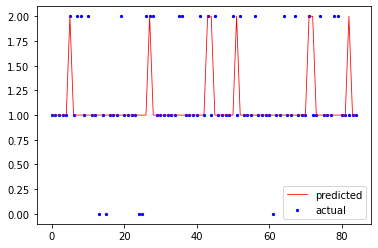

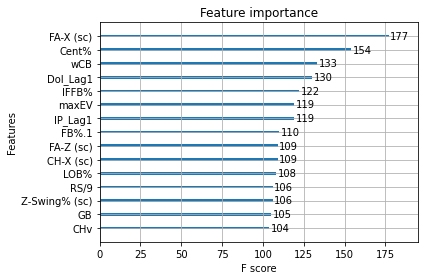

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


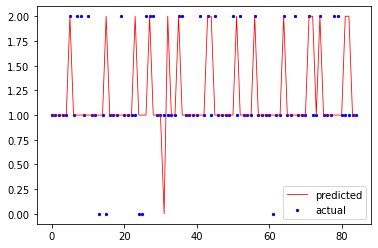

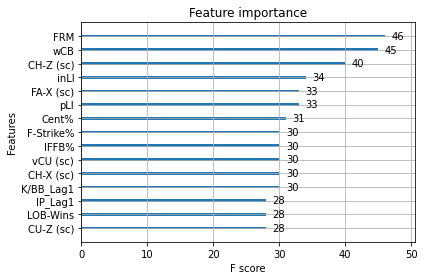

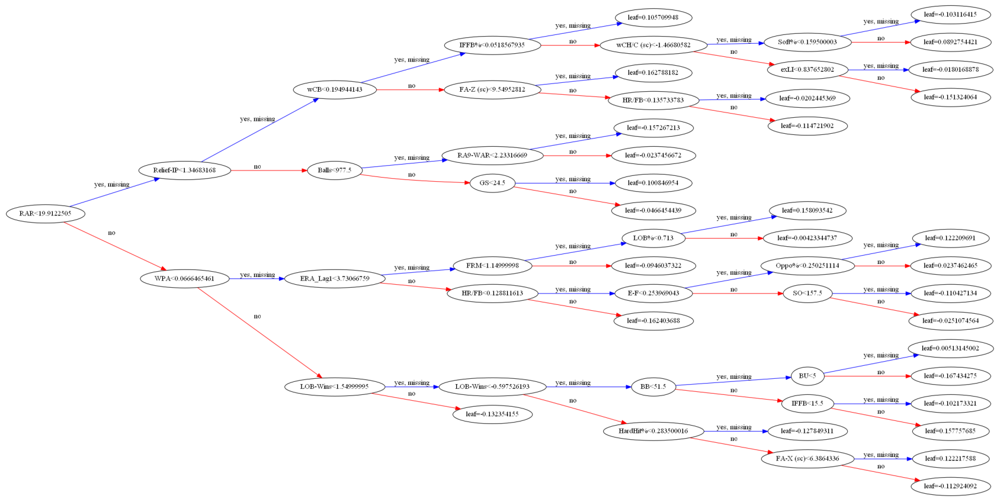

ywc :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  0.9970588235294118
Mean cross-validation score: 0.54
K-fold CV average score: 0.55
Precision: 44.50%
Recall: 55.29%
Outlier Precision: 64.86%
Outlier Recall: 10.81%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


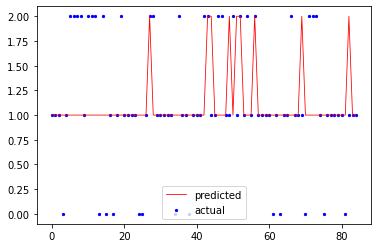

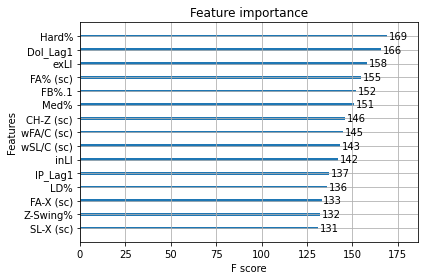

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


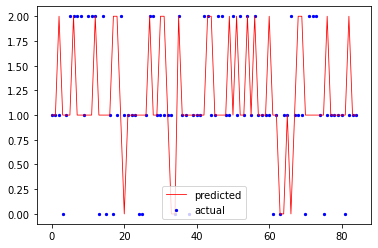

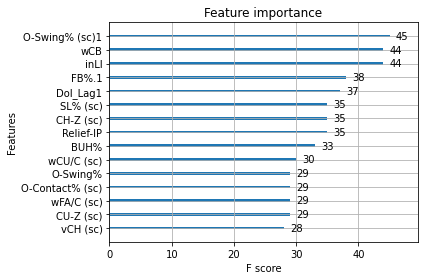

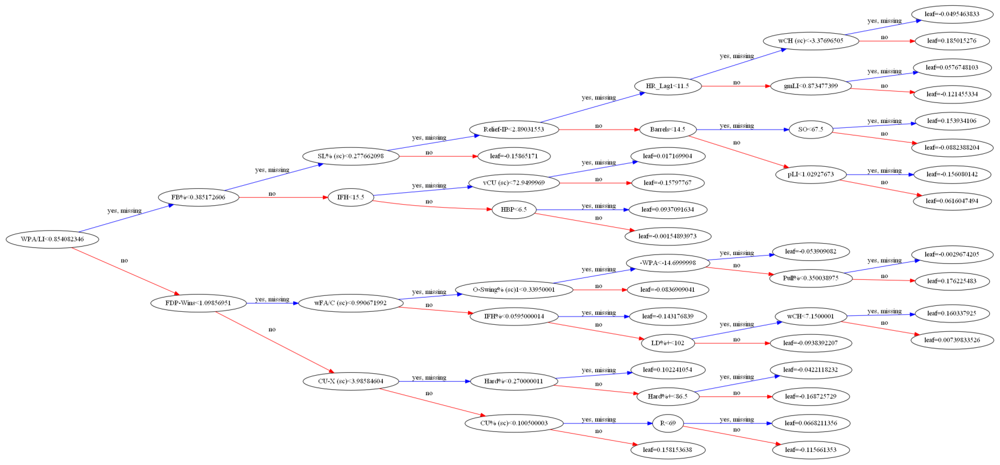

ylc :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.51
K-fold CV average score: 0.49
Precision: 46.89%
Recall: 51.76%
Outlier Precision: 66.21%
Outlier Recall: 53.33%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


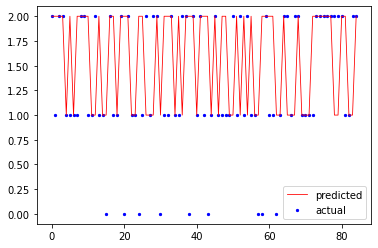

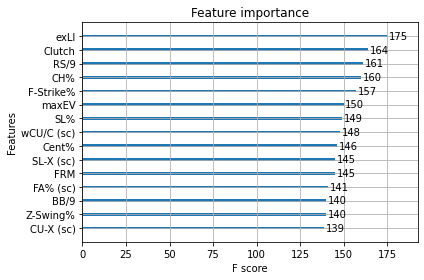

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


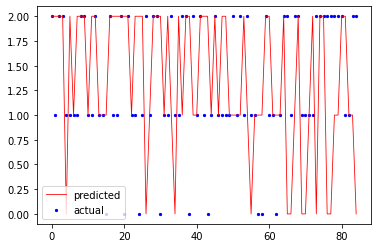

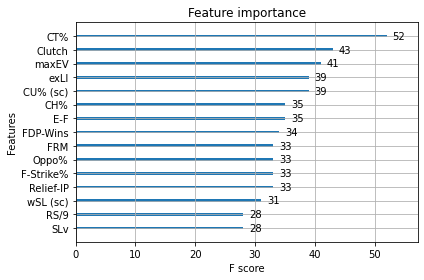

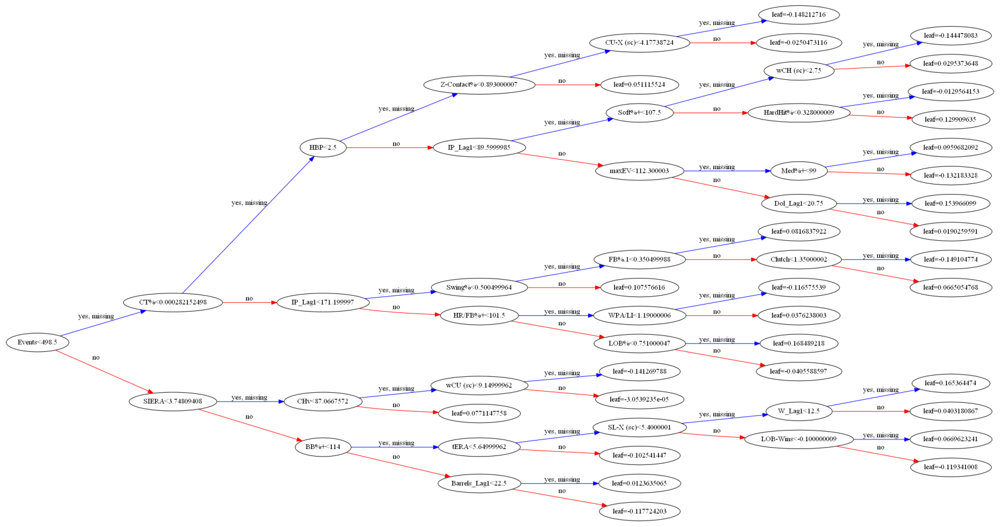

ykc :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  0.961764705882353
Mean cross-validation score: 0.75
K-fold CV average score: 0.76
Precision: 65.49%
Recall: 74.12%
Outlier Precision: 64.00%
Outlier Recall: 24.00%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


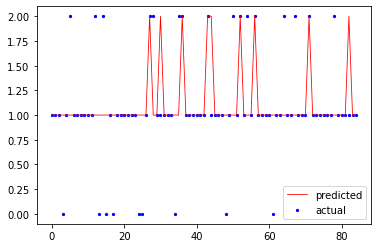

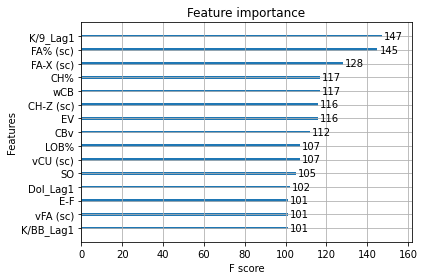

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


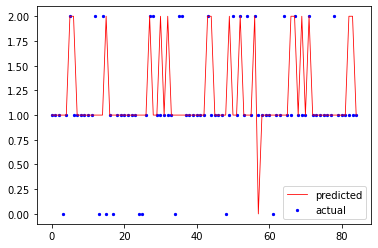

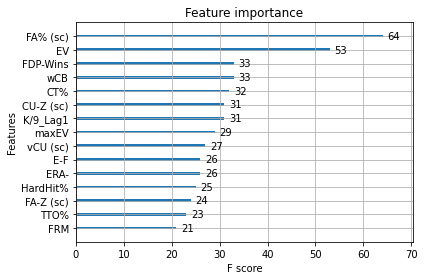

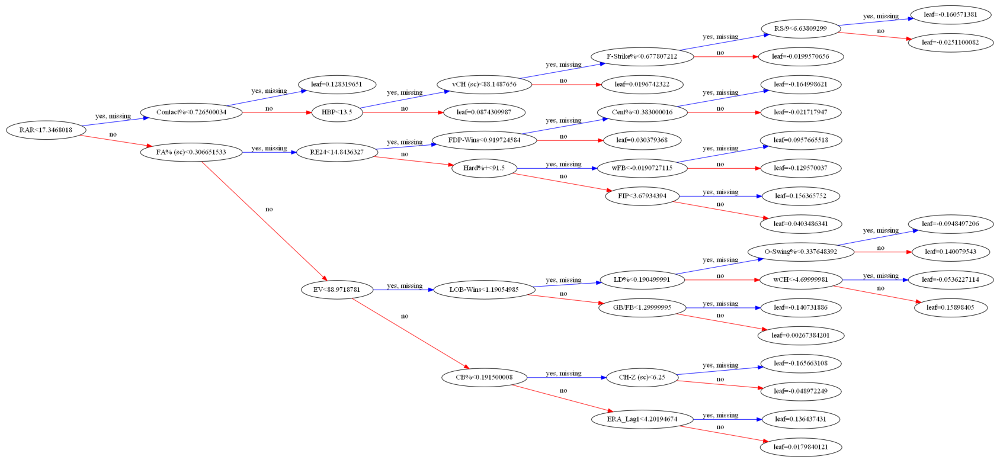

yhrac :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  0.9882352941176471
Mean cross-validation score: 0.55
K-fold CV average score: 0.57
Precision: 57.38%
Recall: 57.65%
Outlier Precision: 97.22%
Outlier Recall: 52.78%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


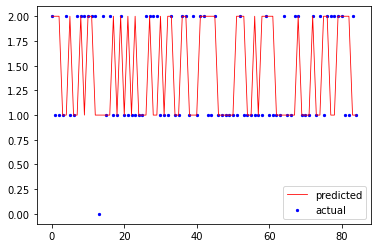

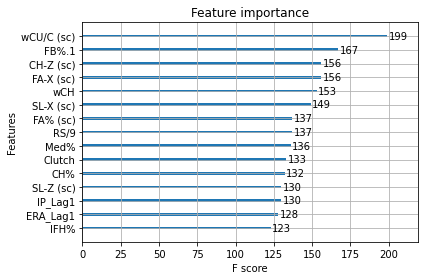

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


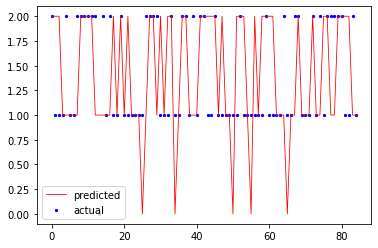

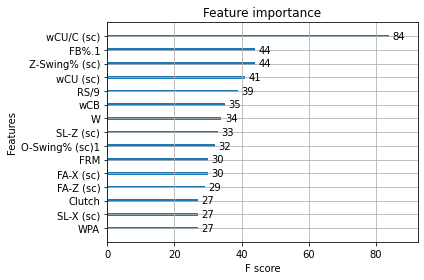

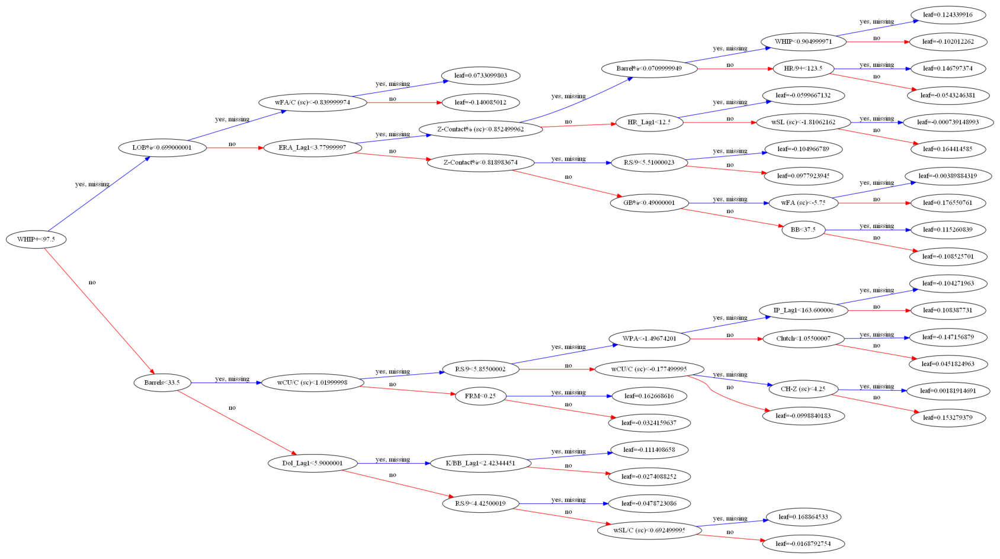

yerac :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.37
K-fold CV average score: 0.39
Precision: 39.37%
Recall: 42.35%
Outlier Precision: 59.27%
Outlier Recall: 41.82%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


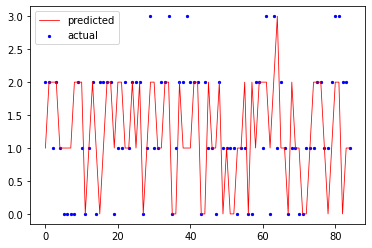

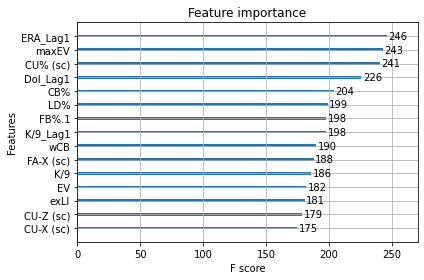

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


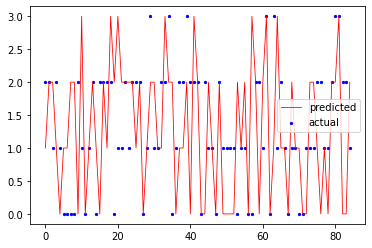

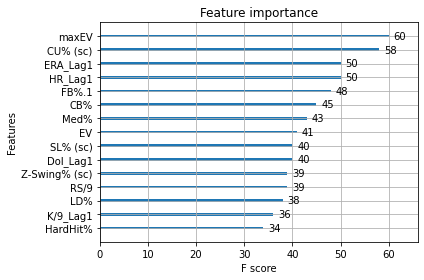

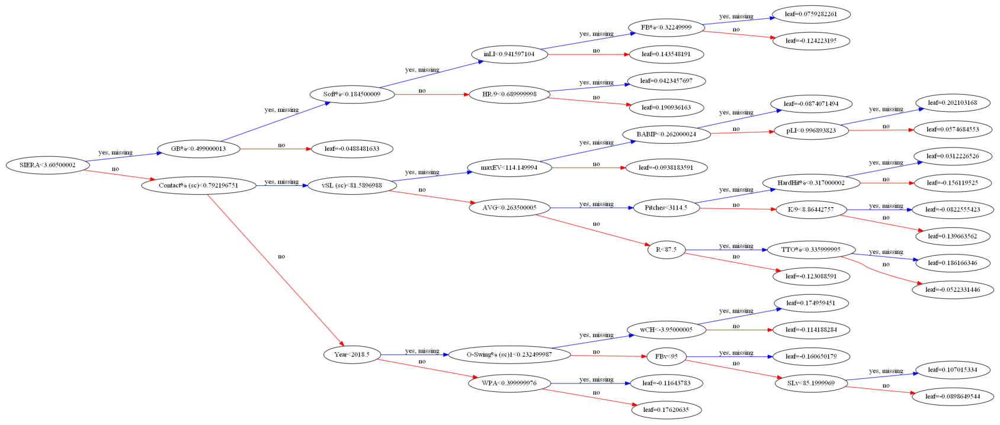

ywhipc :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.42
K-fold CV average score: 0.41
Precision: 39.93%
Recall: 50.59%
Outlier Precision: 41.26%
Outlier Recall: 14.63%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


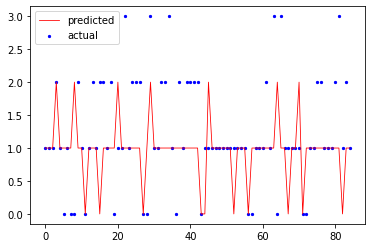

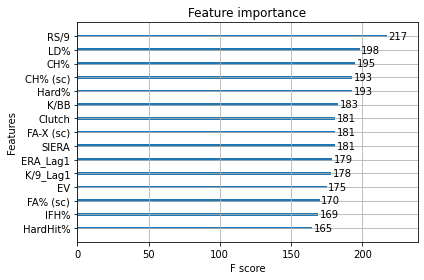

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


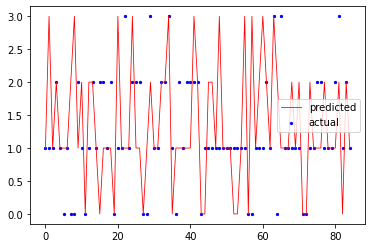

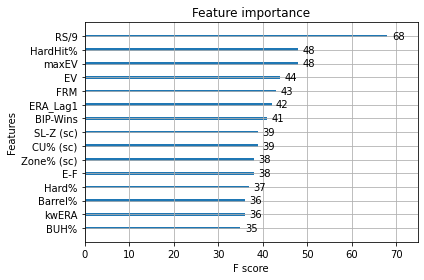

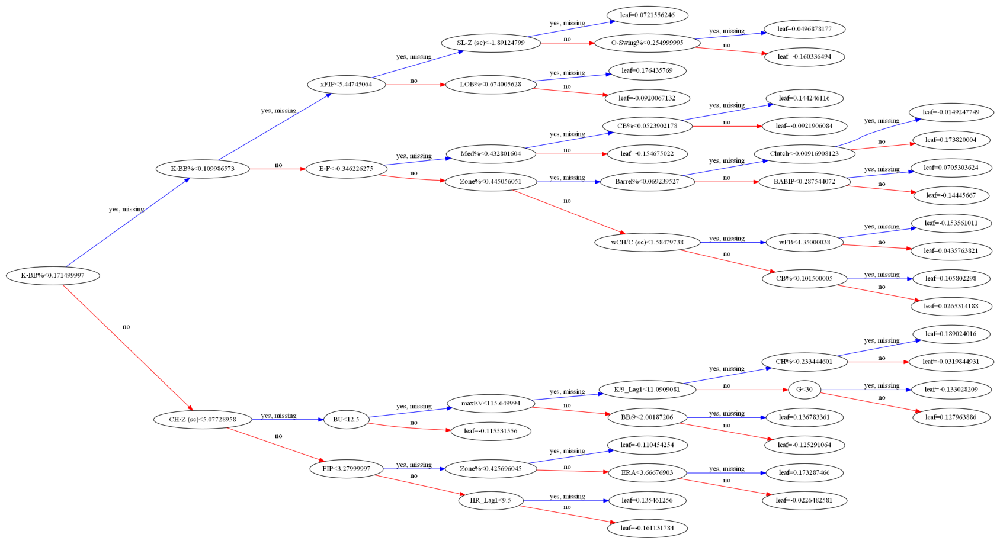

ydolpc :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.56
K-fold CV average score: 0.54
Precision: 55.00%
Recall: 63.53%
Outlier Precision: 64.10%
Outlier Recall: 30.77%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


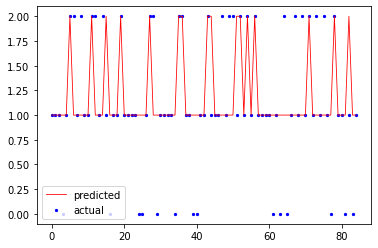

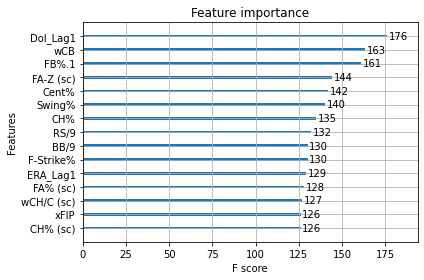

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


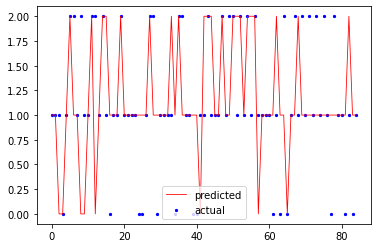

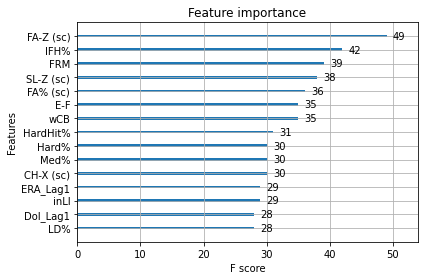

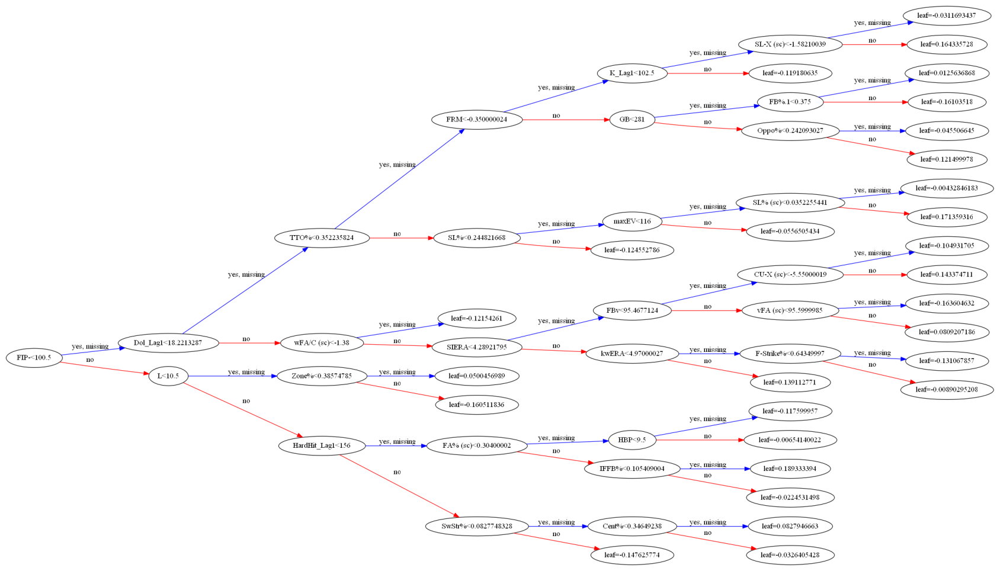

In [40]:
# Set reproducible random state and stratified kfold splits
RANDOMSTATE = 120
kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=RANDOMSTATE)

# Train XGBoost classifier and tune hyperparemeters for each target variable
for i in range(len(ycs)):
    print(names[i],':')
    y = ycs[i]
    xtrain, xtest, ytrain, ytest = train_test_split(Xc, y, test_size=0.2, random_state=RANDOMSTATE)
    clf_tuning(xtrain, ytrain, names[i], kfold)

In [36]:
# Load 162-game scaled 2020 data: final prediction test set
df20 = pd.read_csv('2020sp.csv')

In [37]:
dftest = df20.drop(['playerid', 'Name', 'Team', 'League', 'Team_Traded', 'League_Traded', 'Team_Lag1', 
          'League_Lag1', 'IP_Tgt', 'W_Tgt', 'L_Tgt', 'SV_Tgt', 'BS_Tgt', 'HLD_Tgt', 'K_Tgt', 'HR_Tgt', 'ERA_Tgt', 
          'WHIP_Tgt', 'Dol_Tgt', 'IP_Tgt_Cat', 'W_Tgt_Cat', 'L_Tgt_Cat', 'SV_Tgt_Cat', 'BS_Tgt_Cat', 
          'HLD_Tgt_Cat', 'K_Tgt_Cat', 'HR_Tgt_Cat', 
          'ERA_Tgt_Cat', 'WHIP_Tgt_Cat', 'Dol_Tgt_Cat', 'IP_Tgt_Code', 'W_Tgt_Code', 'L_Tgt_Code', 'SV_Tgt_Code', 'BS_Tgt_Code', 
          'HLD_Tgt_Code', 'K_Tgt_Code', 'HR_Tgt_Code', 'ERA_Tgt_Code', 'WHIP_Tgt_Code', 'Dol_Tgt_Code'], axis=1)

In [38]:
# Load all regression and classification models, predict 2021 values for all statistics 
# Set saves, blown saves, and holds to zero for starting pitchers

ip_model = joblib.load('yip_1619.joblib.dat')
df20['IP_21'] = ip_model.predict(dftest)

w_model = joblib.load('yw_1619.joblib.dat')
df20['W_21'] = w_model.predict(dftest)

l_model = joblib.load('yl_1619.joblib.dat')
df20['L_21'] = l_model.predict(dftest)

df20['SV_21'] = 0
df20['BS_21'] = 0
df20['HLD_21'] = 0

k_model = joblib.load('yk_1619.joblib.dat')
df20['K_21'] = k_model.predict(dftest)

hra_model = joblib.load('yhra_1619.joblib.dat')
df20['HRA_21'] = hra_model.predict(dftest)

era_model = joblib.load('yera_1619.joblib.dat')
df20['ERA_21'] = era_model.predict(dftest)

whip_model = joblib.load('ywhip_1619.joblib.dat')
df20['WHIP_21'] = whip_model.predict(dftest)

dolp_model = joblib.load('ydolp_1619.joblib.dat')
df20['DolP_21'] = dolp_model.predict(dftest)

ipc_model = joblib.load('yipc_clf.joblib.dat')
df20['IP_Tier'] = ipc_model.predict(dftest)

wc_model = joblib.load('ywc_clf.joblib.dat')
df20['W_Tier'] = wc_model.predict(dftest)

lc_model = joblib.load('ylc_clf.joblib.dat')
df20['L_Tier'] = lc_model.predict(dftest)

df20['SV_Tier'] = 0
df20['BS_Tier'] = 0
df20['HLD Tier'] = 0

kc_model = joblib.load('ykc_clf.joblib.dat')
df20['K_Tier'] = kc_model.predict(dftest)

hrac_model = joblib.load('yhrac_clf.joblib.dat')
df20['HRA_Tier'] = hrac_model.predict(dftest)

erac_model = joblib.load('yerac_clf.joblib.dat')
df20['ERA_Tier'] = erac_model.predict(dftest)

whipc_model = joblib.load('ywhipc_clf.joblib.dat')
df20['WHIP_Tier'] = whipc_model.predict(dftest)

dolpc_model = joblib.load('ydolpc_clf.joblib.dat')
df20['DolP_Tier'] = dolpc_model.predict(dftest)

In [22]:
# Export starting pitcher projections
df20.to_csv('2021_sp_projections.csv')

## Modeling Part 4: XGBoost Classification for Relief Pitchers

In [23]:
# Load 2016-19 relief pitcher data
dfcrp = pd.read_csv('2016-19rp.csv')

In [41]:
# Define all relief pitcher features
Xcr = dfcrp.drop(['playerid', 'Name', 'Team', 'League', 'Team_Traded', 'League_Traded', 'Team_Lag1', 
          'League_Lag1', 'IP_Tgt', 'W_Tgt', 'L_Tgt', 'SV_Tgt', 'BS_Tgt', 'HLD_Tgt', 'K_Tgt', 'HR_Tgt', 'ERA_Tgt', 
          'WHIP_Tgt', 'Dol_Tgt', 'IP_Tgt_Cat', 'W_Tgt_Cat', 'L_Tgt_Cat', 'SV_Tgt_Cat', 'BS_Tgt_Cat', 
          'HLD_Tgt_Cat', 'K_Tgt_Cat', 'HR_Tgt_Cat', 
          'ERA_Tgt_Cat', 'WHIP_Tgt_Cat', 'Dol_Tgt_Cat', 'IP_Tgt_Code', 'W_Tgt_Code', 'L_Tgt_Code', 'SV_Tgt_Code', 'BS_Tgt_Code', 
          'HLD_Tgt_Code', 'K_Tgt_Code', 'HR_Tgt_Code', 'ERA_Tgt_Code', 'WHIP_Tgt_Code', 'Dol_Tgt_Code', 'Year'], axis=1)
ycr = dfcrp['IP_Tgt']

In [42]:
# Define all relief pitcher target variables
yrip = dfcrp['IP_Tgt_Code']
yrw = dfcrp['W_Tgt_Code']
yrl = dfcrp['L_Tgt_Code']
yrsv = dfcrp['SV_Tgt_Code']
yrbs = dfcrp['BS_Tgt_Code']
yrhld = dfcrp['HLD_Tgt_Code']
yrk = dfcrp['K_Tgt_Code']
yrhra = dfcrp['HR_Tgt_Code']
yrera = dfcrp['ERA_Tgt_Code']
yrwhip = dfcrp['WHIP_Tgt_Code']
yrdolp = dfcrp['Dol_Tgt_Code']

# Define lists of target variables and names
ycr = [dfcrp['IP_Tgt_Code'], dfcrp['W_Tgt_Code'], dfcrp['L_Tgt_Code'], dfcrp['SV_Tgt_Code'], dfcrp['BS_Tgt_Code'], 
       dfcrp['HLD_Tgt_Code'], dfcrp['K_Tgt_Code'], dfcrp['HR_Tgt_Code'], dfcrp['ERA_Tgt_Code'], dfcrp['WHIP_Tgt_Code'], 
       dfcrp['Dol_Tgt_Code']]
names = ['yrip', 'yrw', 'yrl', 'yrsv', 'yrbs', 'yrhld', 'yrk', 'yrhra', 'yrera', 'yrwhip', 'yrdolp']

yrip :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  0.95
Mean cross-validation score: 0.75
K-fold CV average score: 0.75
Precision: 58.78%
Recall: 76.67%
Outlier Precision: 0.00%
Outlier Recall: 0.00%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


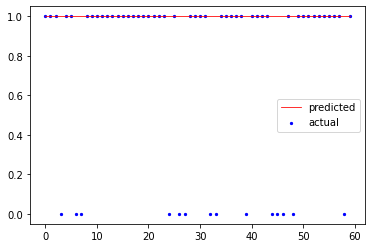

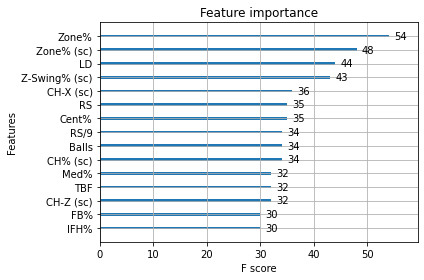

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


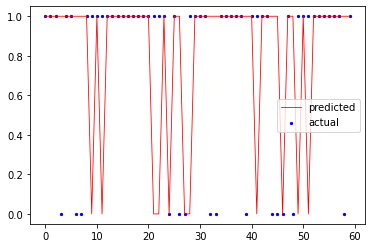

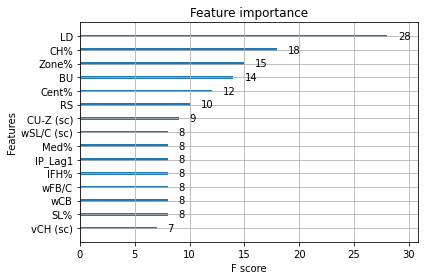

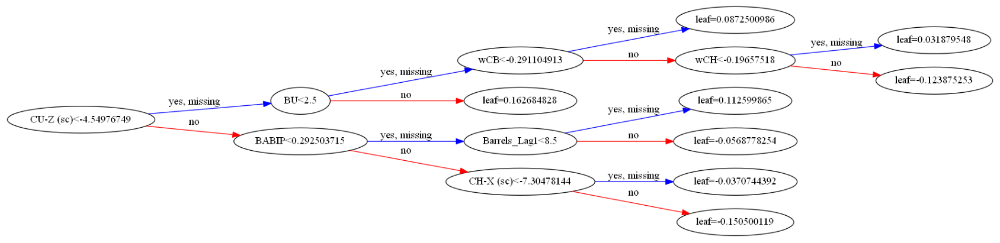

yrw :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.40
K-fold CV average score: 0.41
Precision: 32.41%
Recall: 31.67%
Outlier Precision: 41.07%
Outlier Recall: 25.00%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


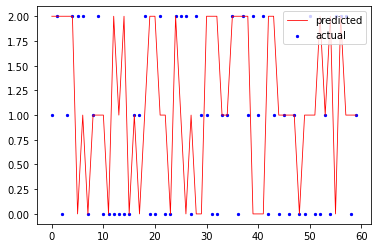

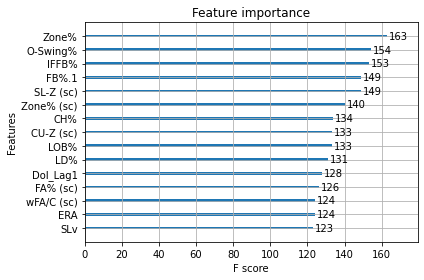

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


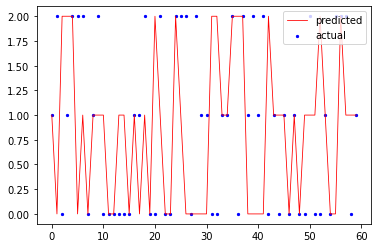

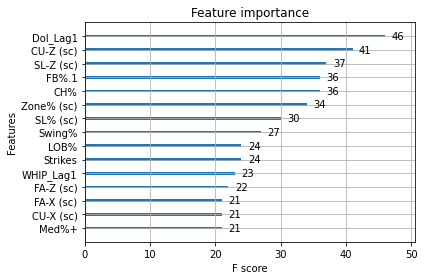

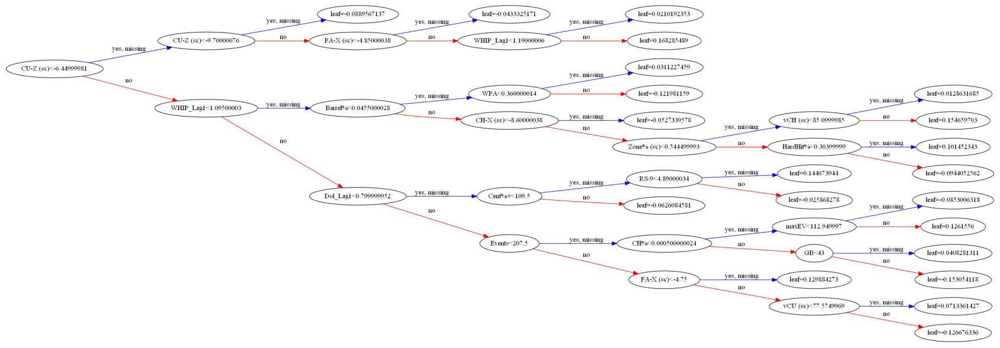

yrl :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.42
K-fold CV average score: 0.39
Precision: 39.24%
Recall: 41.67%
Outlier Precision: 68.70%
Outlier Recall: 53.66%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


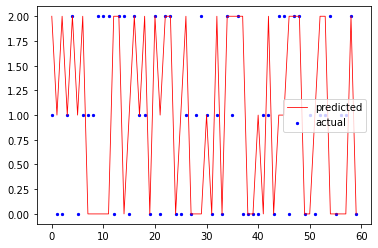

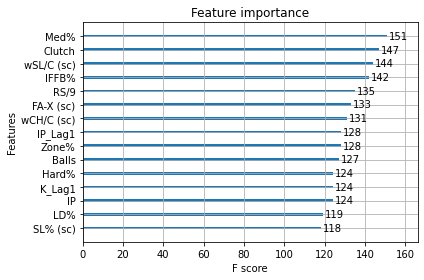

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


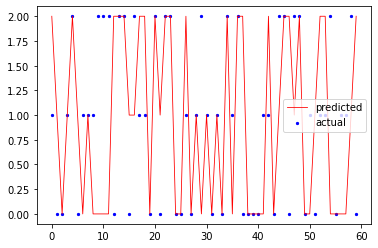

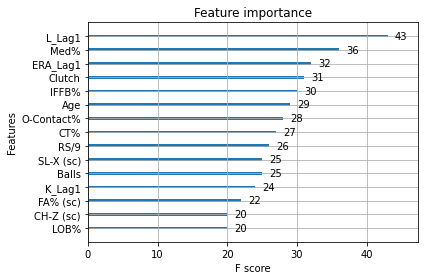

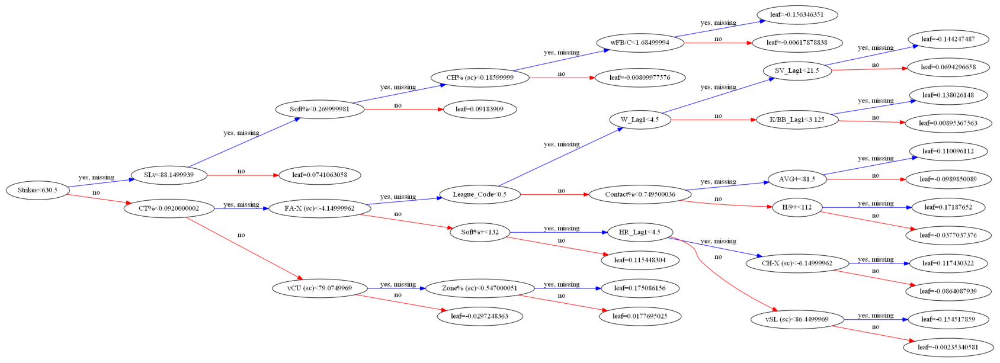

yrsv :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  0.9666666666666667
Mean cross-validation score: 0.78
K-fold CV average score: 0.74
Precision: 91.57%
Recall: 93.33%
Outlier Precision: 94.70%
Outlier Recall: 94.92%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


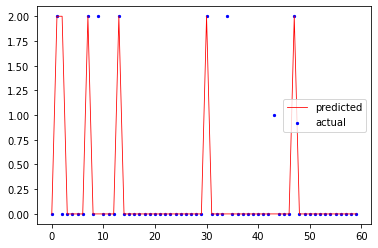

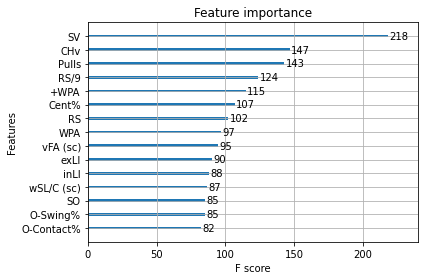

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


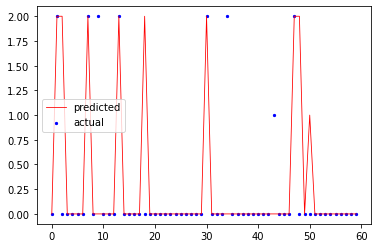

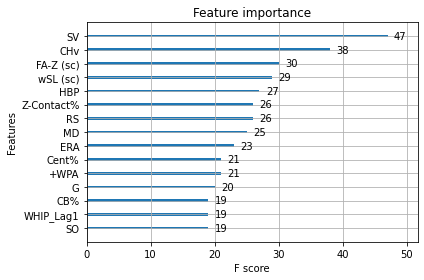

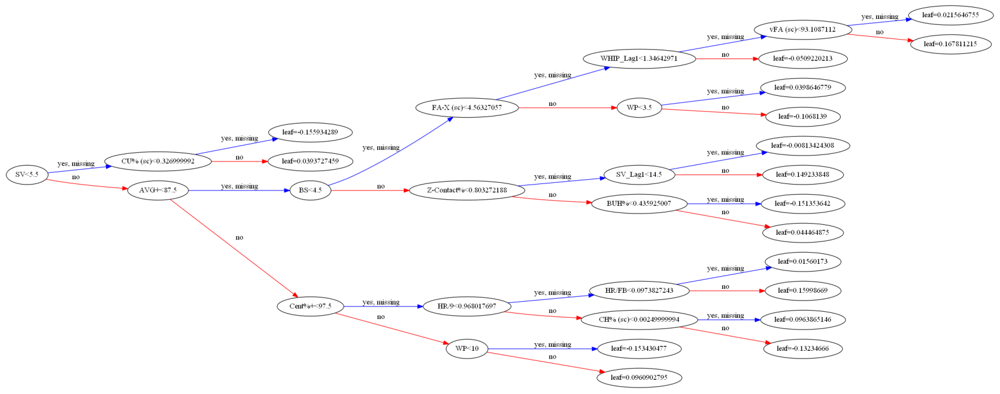

yrbs :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  0.9916666666666667
Mean cross-validation score: 0.56
K-fold CV average score: 0.53
Precision: 51.49%
Recall: 60.00%
Outlier Precision: 86.64%
Outlier Recall: 76.09%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


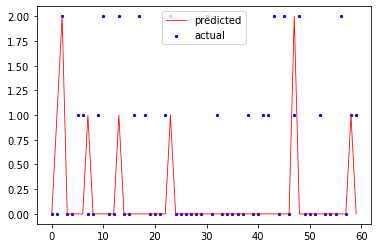

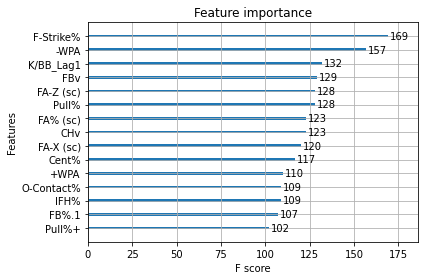

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


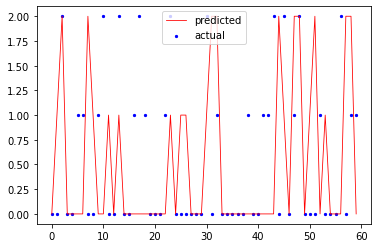

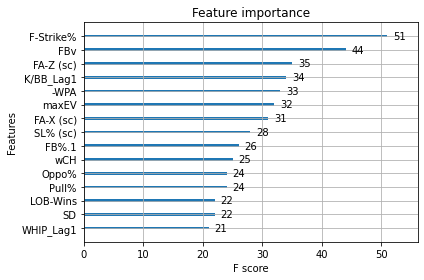

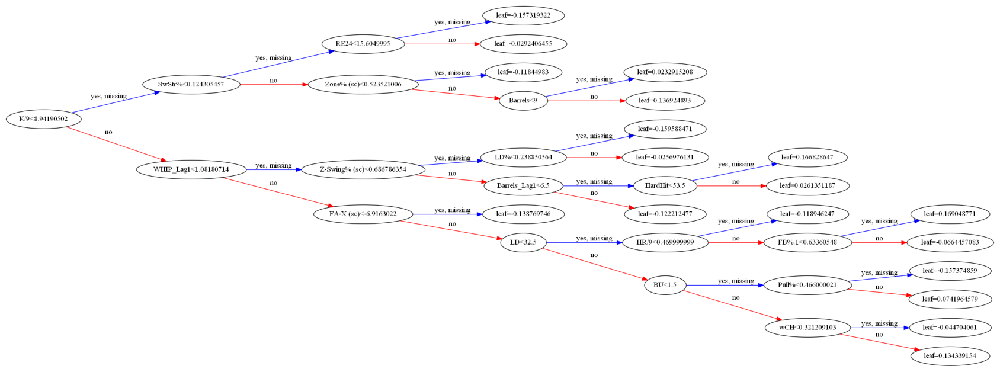

yrhld :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.39
K-fold CV average score: 0.41
Precision: 53.61%
Recall: 55.00%
Outlier Precision: 65.40%
Outlier Recall: 40.62%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


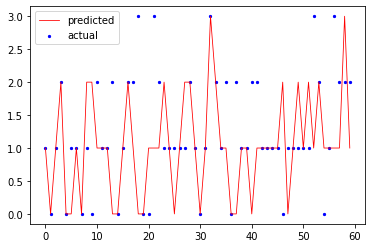

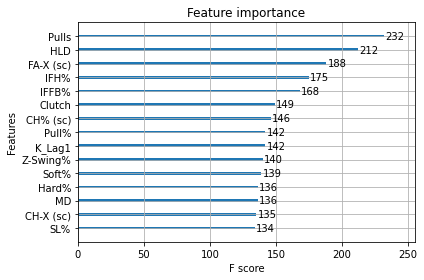

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


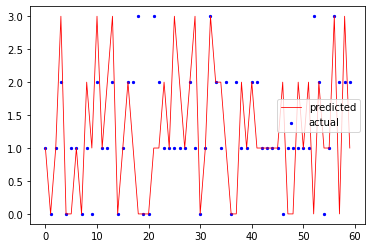

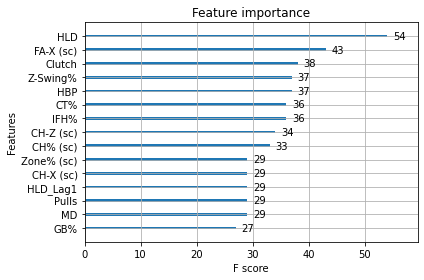

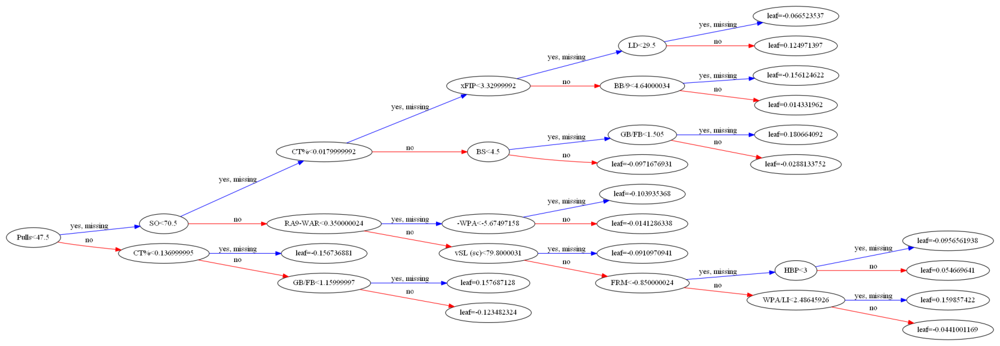

yrk :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.57
K-fold CV average score: 0.55
Precision: 64.29%
Recall: 58.33%
Outlier Precision: 100.00%
Outlier Recall: 38.71%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


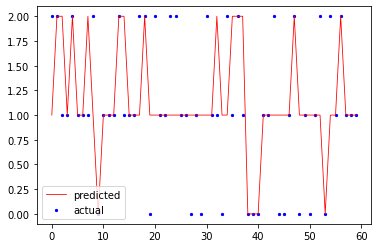

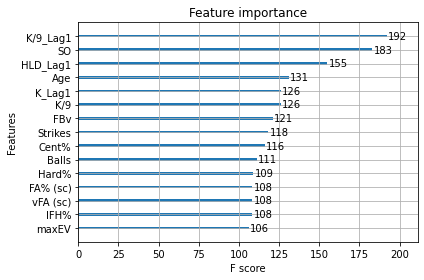

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


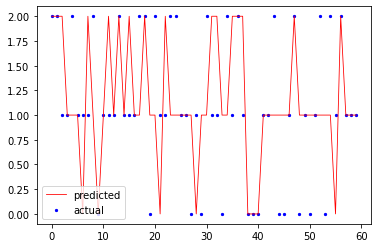

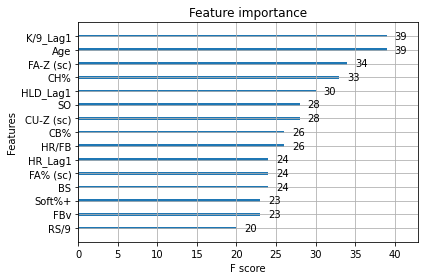

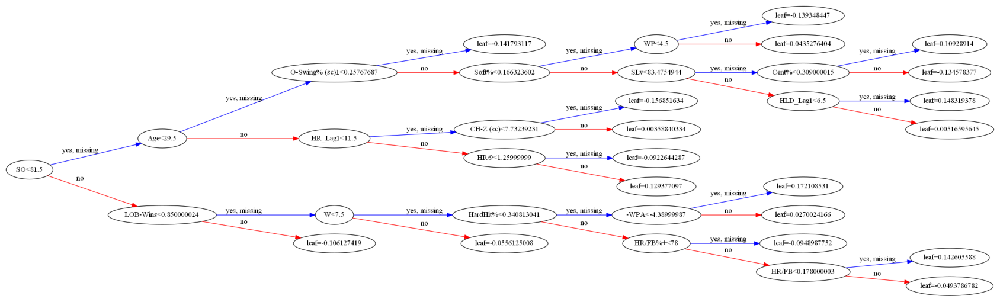

yrhra :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.44
K-fold CV average score: 0.45
Precision: 46.47%
Recall: 48.33%
Outlier Precision: 58.57%
Outlier Recall: 21.43%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


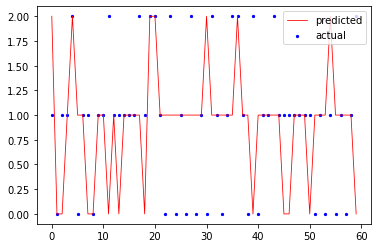

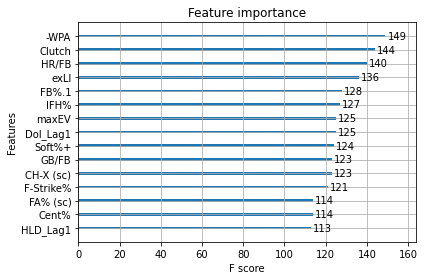

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


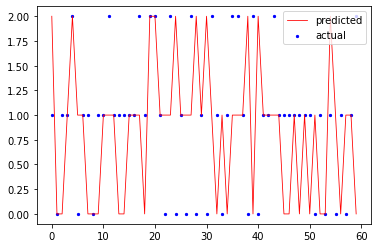

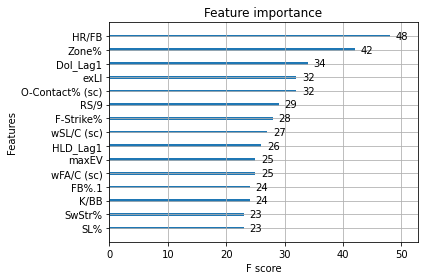

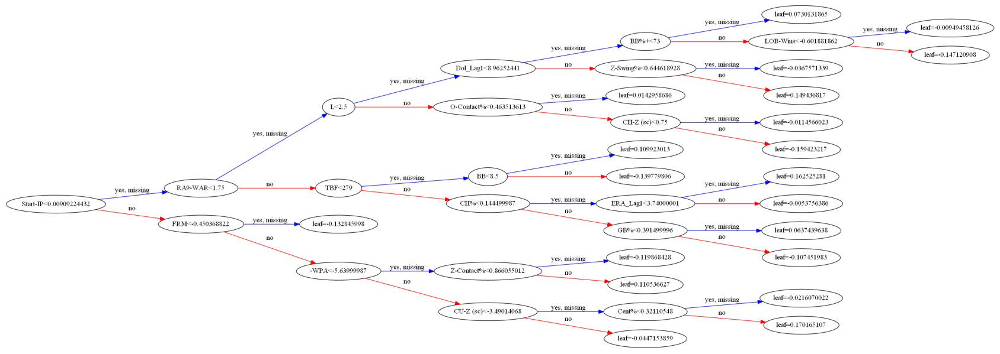

yrera :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.37
K-fold CV average score: 0.39
Precision: 40.48%
Recall: 40.00%
Outlier Precision: 63.95%
Outlier Recall: 41.86%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


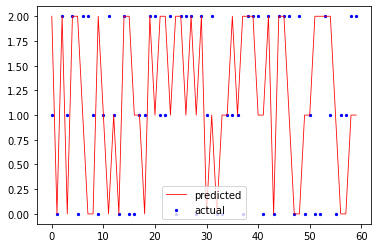

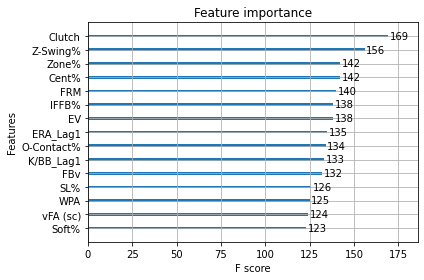

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


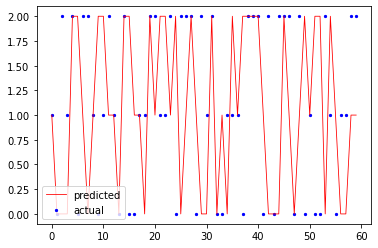

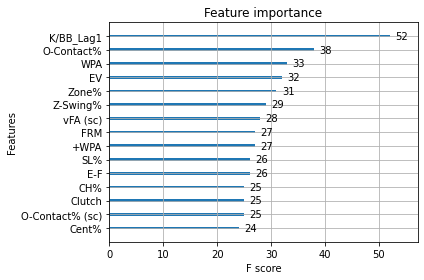

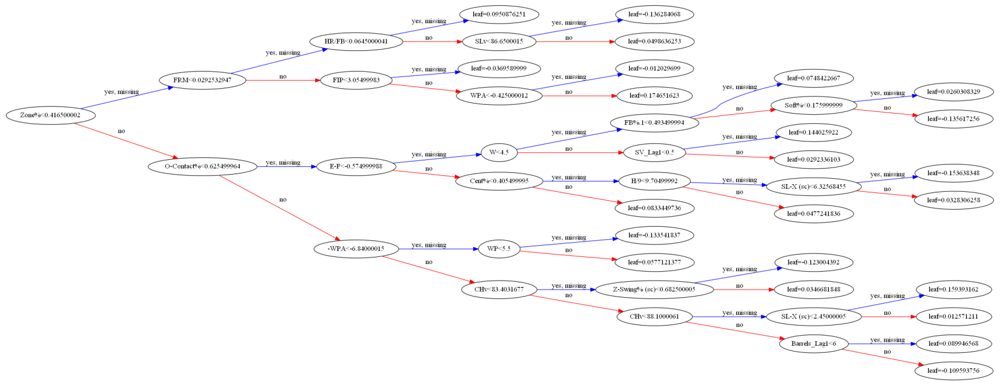

yrwhip :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.35
K-fold CV average score: 0.35
Precision: 37.76%
Recall: 45.00%
Outlier Precision: 77.66%
Outlier Recall: 72.22%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


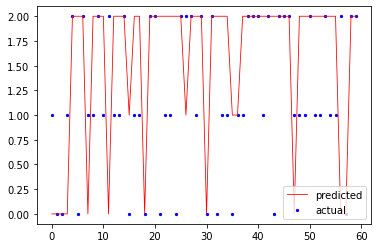

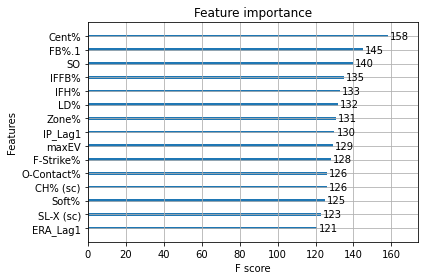

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


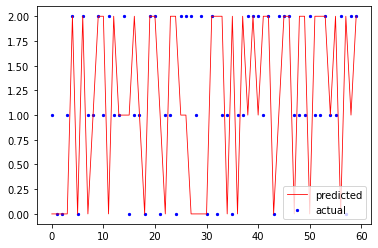

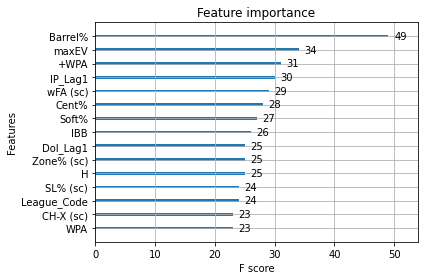

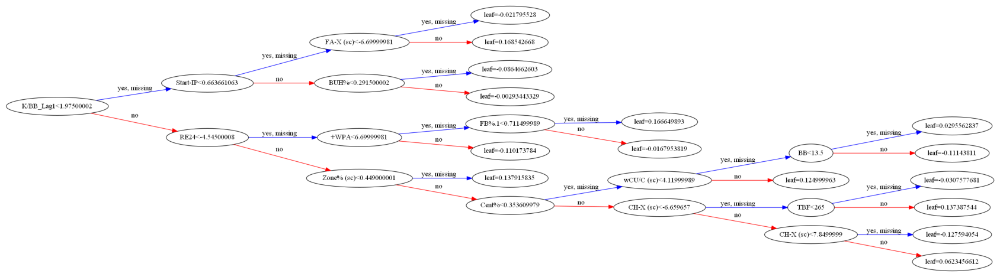

yrdolp :
XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.3, eval_metric='merror',
              gamma=None, gpu_id=None, importance_type='gain',
              interaction_constraints=None, learning_rate=0.01,
              max_delta_step=None, max_depth=5, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=500,
              n_jobs=None, num_parallel_tree=None, random_state=None,
              reg_alpha=None, reg_lambda=None, scale_pos_weight=None,
              subsample=0.4, tree_method=None, use_label_encoder=False,
              validate_parameters=None, verbosity=0)
Training score:  1.0
Mean cross-validation score: 0.47
K-fold CV average score: 0.48
Precision: 57.24%
Recall: 60.00%
Outlier Precision: 82.71%
Outlier Recall: 81.40%


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


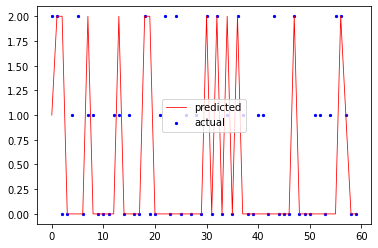

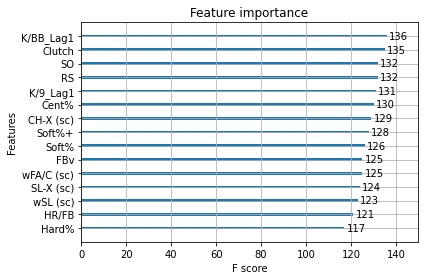

Pipeline(steps=[('smote', SMOTE(random_state=120)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='merror',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=None, reg_alpha=None,
                               reg_lambda=None, scale_pos_weight=None,
                               subsample=None, tree_method=None,
                               use_label_encoder=False,


C:\Users\pette\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


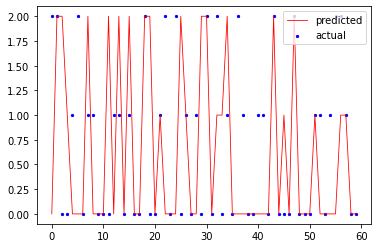

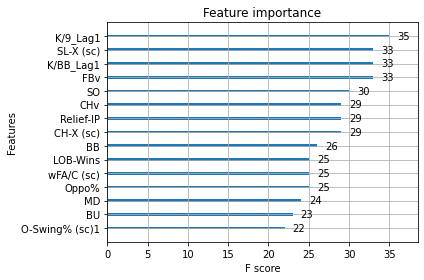

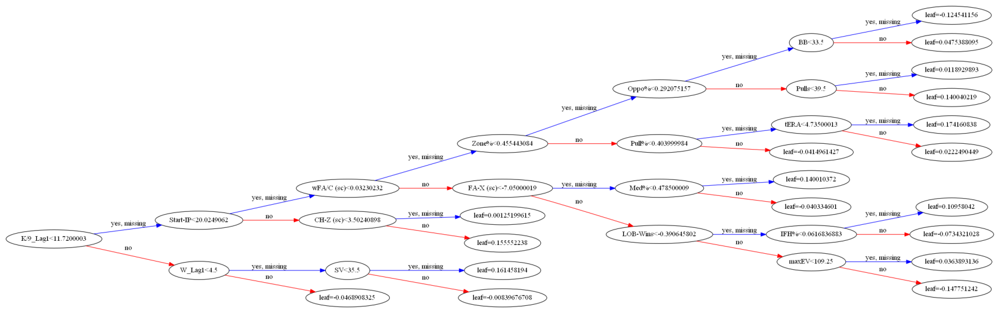

In [43]:
# Train XGBoost classifier and tune hyperparemeters for each target variable

for i in range(len(ycr)):
    print(names[i],':')
    y = ycr[i]
    xtrain, xtest, ytrain, ytest = train_test_split(Xcr, y, test_size=0.2, random_state=RANDOMSTATE)
    clf_tuning(xtrain, ytrain, names[i], kfold)

In [39]:
# Load 162-game scaled 2020 data: final prediction test set
df20rp = pd.read_csv('2020rp.csv')

In [40]:
dfrtest = df20rp.drop(['playerid', 'Name', 'Team', 'League', 'Team_Traded', 'League_Traded', 'Team_Lag1', 
          'League_Lag1', 'IP_Tgt', 'W_Tgt', 'L_Tgt', 'SV_Tgt', 'BS_Tgt', 'HLD_Tgt', 'K_Tgt', 'HR_Tgt', 'ERA_Tgt', 
          'WHIP_Tgt', 'Dol_Tgt', 'IP_Tgt_Cat', 'W_Tgt_Cat', 'L_Tgt_Cat', 'SV_Tgt_Cat', 'BS_Tgt_Cat', 
          'HLD_Tgt_Cat', 'K_Tgt_Cat', 'HR_Tgt_Cat', 
          'ERA_Tgt_Cat', 'WHIP_Tgt_Cat', 'Dol_Tgt_Cat', 'IP_Tgt_Code', 'W_Tgt_Code', 'L_Tgt_Code', 'SV_Tgt_Code', 'BS_Tgt_Code', 
          'HLD_Tgt_Code', 'K_Tgt_Code', 'HR_Tgt_Code', 'ERA_Tgt_Code', 'WHIP_Tgt_Code', 'Dol_Tgt_Code', 'Year'], axis=1)

In [41]:
# Load all regression and classification models, predict 2021 values for all statistics for relief pitchers

ip_model = joblib.load('yrip_1619.joblib.dat')
df20rp['IP_21'] = ip_model.predict(dfrtest)

w_model = joblib.load('yrw_1619.joblib.dat')
df20rp['W_21'] = w_model.predict(dfrtest)

l_model = joblib.load('yrl_1619.joblib.dat')
df20rp['L_21'] = l_model.predict(dfrtest)

sv_model = joblib.load('yrsv_1619.joblib.dat')
df20rp['SV_21'] = sv_model.predict(dfrtest)

bs_model = joblib.load('yrbs_1619.joblib.dat')
df20rp['BS_21'] = bs_model.predict(dfrtest)

hld_model = joblib.load('yrhld_1619.joblib.dat')
df20rp['HLD_21'] = hld_model.predict(dfrtest)

k_model = joblib.load('yrk_1619.joblib.dat')
df20rp['K_21'] = k_model.predict(dfrtest)

hra_model = joblib.load('yrhra_1619.joblib.dat')
df20rp['HRA_21'] = hra_model.predict(dfrtest)

era_model = joblib.load('yrera_1619.joblib.dat')
df20rp['ERA_21'] = era_model.predict(dfrtest)

whip_model = joblib.load('yrwhip_1619.joblib.dat')
df20rp['WHIP_21'] = whip_model.predict(dfrtest)

dolp_model = joblib.load('yrdolp_1619.joblib.dat')
df20rp['DolP_21'] = dolp_model.predict(dfrtest)

ipc_model = joblib.load('yrip_clf.joblib.dat')
df20rp['IP_Tier'] = ipc_model.predict(dftest)

wc_model = joblib.load('yrw_clf.joblib.dat')
df20rp['W_Tier'] = wc_model.predict(dftest)

lc_model = joblib.load('yrl_clf.joblib.dat')
df20rp['L_Tier'] = lc_model.predict(dftest)

svc_model = joblib.load('yrsv_clf.joblib.dat')
df20rp['SV_Tier'] = svc_model.predict(dftest)

bsc_model = joblib.load('yrbs_clf.joblib.dat')
df20rp['BS_Tier'] = bsc_model.predict(dftest)

hldc_model = joblib.load('yrhld_clf.joblib.dat')
df20rp['HLD_Tier'] = hldc_model.predict(dftest)

kc_model = joblib.load('yrk_clf.joblib.dat')
df20rp['K_Tier'] = kc_model.predict(dftest)

hrac_model = joblib.load('yrhra_clf.joblib.dat')
df20rp['HRA_Tier'] = hrac_model.predict(dftest)

erac_model = joblib.load('yrera_clf.joblib.dat')
df20rp['ERA_Tier'] = erac_model.predict(dftest)

whipc_model = joblib.load('yrwhip_clf.joblib.dat')
df20rp['WHIP_Tier'] = whipc_model.predict(dftest)

dolpc_model = joblib.load('yrdolp_clf.joblib.dat')
df20rp['DolP_Tier'] = dolpc_model.predict(dftest)

In [34]:
# Export relief pitcher projections
df20rp.to_csv('2021_rp_projections.csv')

In [44]:
def shapsum(X, i, model, names):
    """Function to display and save SHAP summary plot."""
    explainer = shap.TreeExplainer(model[i])
    shap_values = explainer.shap_values(X)
    shap.summary_plot(shap_values, X, show=False)
    plt.title('Top 20 Features and Their Impact on Model Output: '+names[i])
    plt.tight_layout()
    plt.savefig('shap_'+names[i]+'.png')
    plt.show()

In [45]:
# Construct lists of all XGBoost regression models and statistic names
sp_models = [ip_model, w_model, l_model, k_model, hra_model, era_model, whip_model, dolp_model]
rp_models = [sv_model, bs_model, hld_model]

sp_names = ['IP', 'W', 'L', 'K', 'HRA', 'ERA', 'WHIP', 'Dol']
rp_names = ['SV', 'BS', 'HLD']

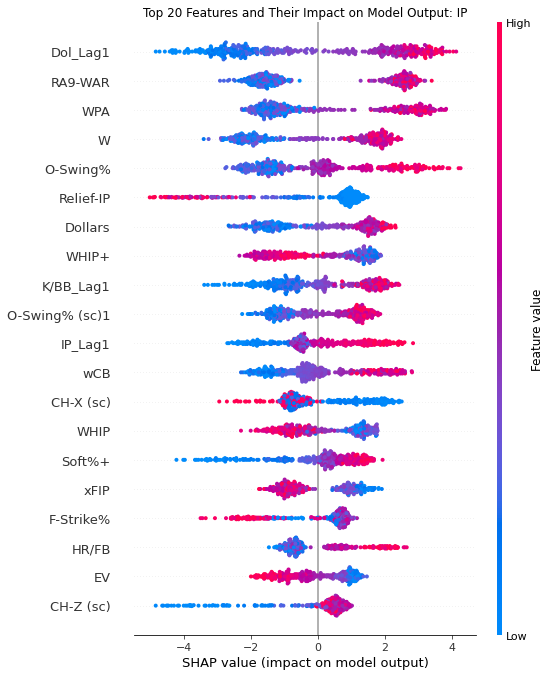

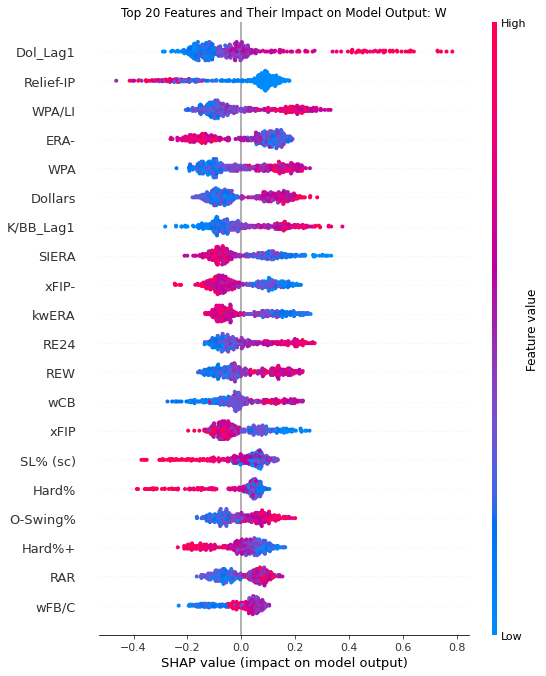

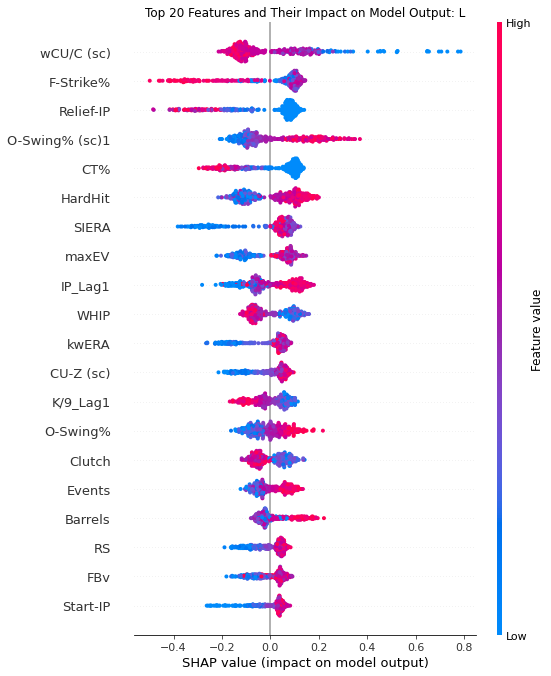

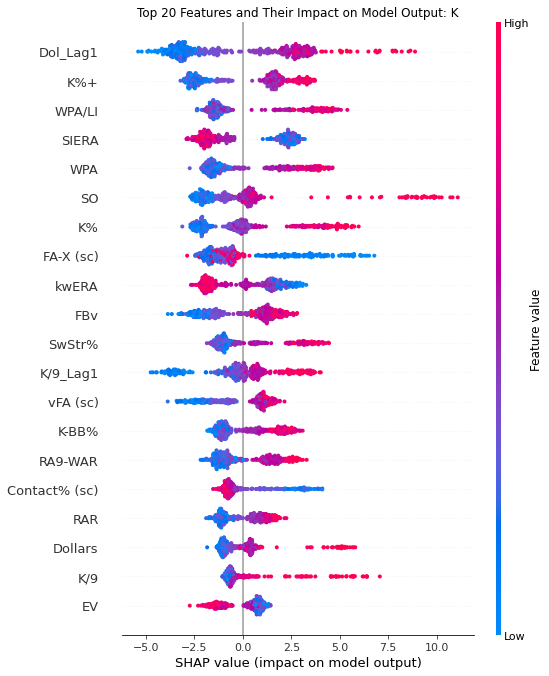

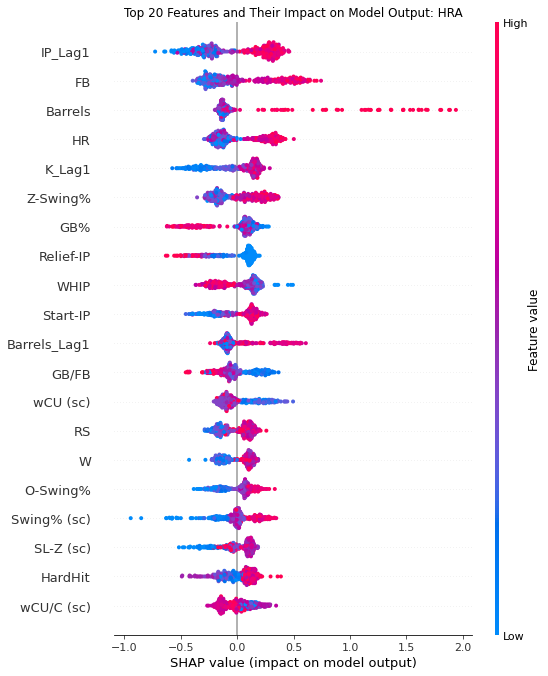

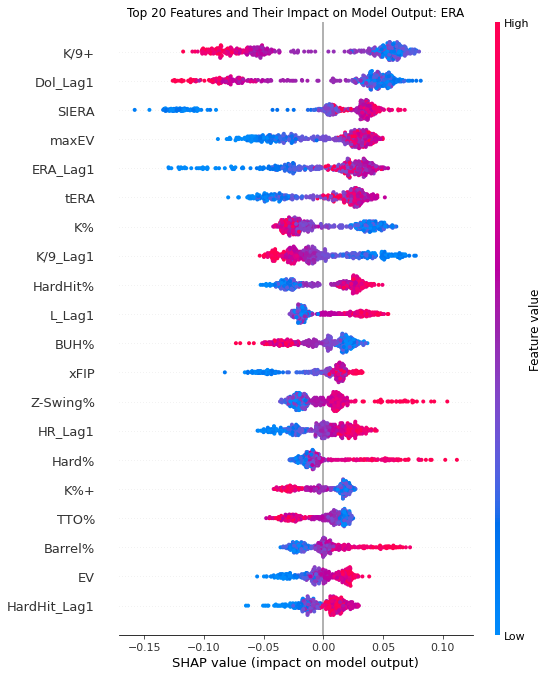

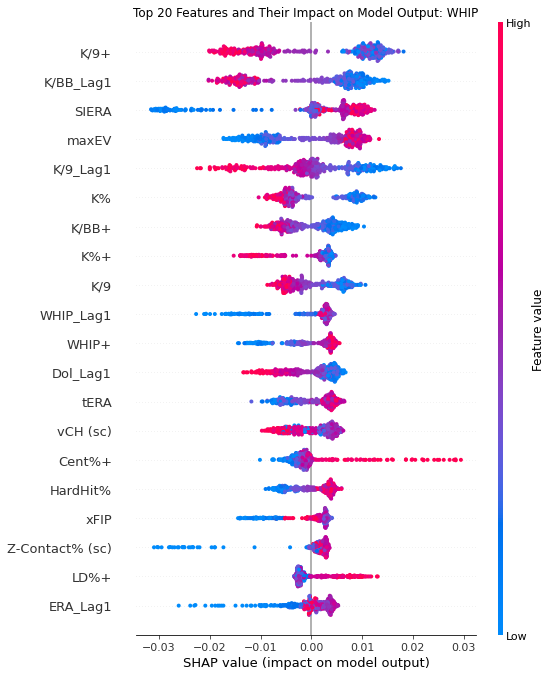

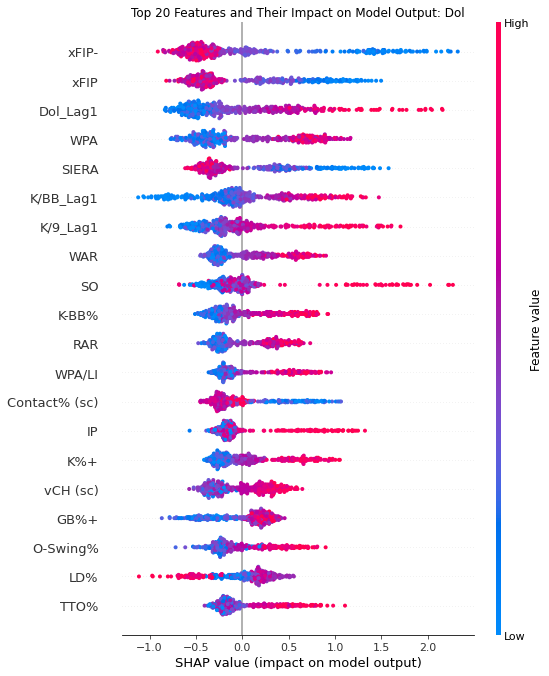

IndexError: list index out of range

In [49]:
# Display and save SHAP summary plots for all starting pitcher statistic regression models
for i in range(len(all_models)):
    shapsum(X, i, sp_models, sp_names)

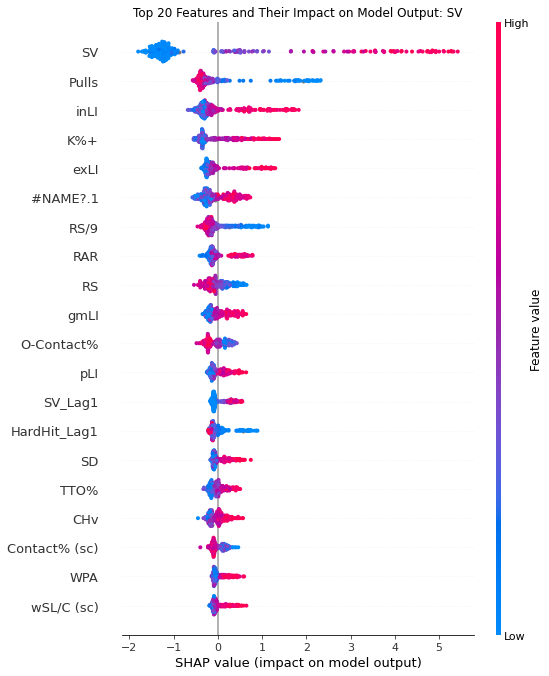

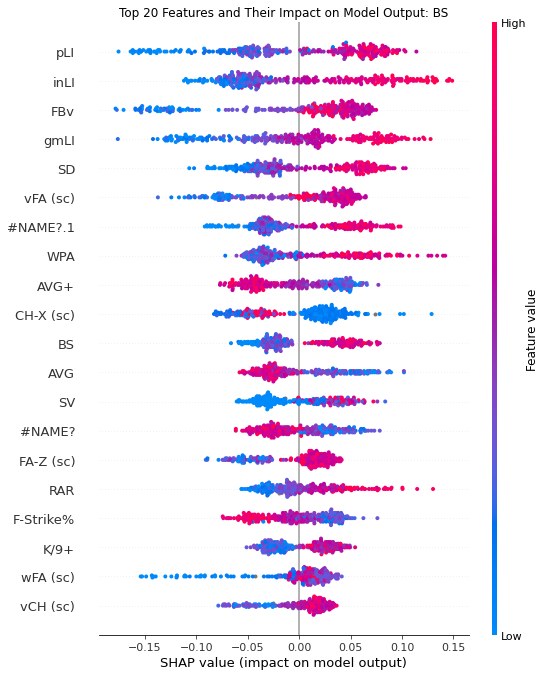

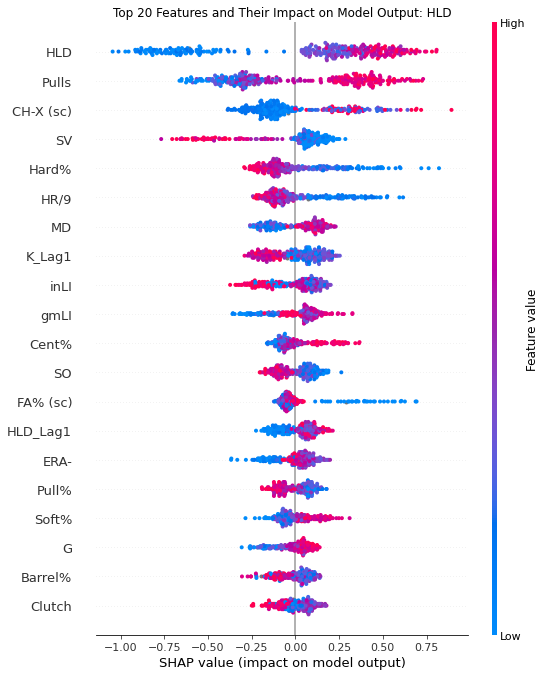

In [48]:
# Display and save SHAP summary plots for relief pitcher statistic regression models
for i in range(len(rp_models)):
    shapsum(Xr, i, rp_models, rp_names)